In [ ]:
!pip install ipywidgets
!pip install statsmodels
!pip install missingno
!pip install ydata-profiling
!pip install tensorflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 37.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 25.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 24.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 61.8 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=1e0ac843313877d214c8ccd117599b7202e604b8f25e0fb79d0624630ca06d65
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


# **IMPORTACIÓN DE LIBRERÍAS PARA WIDGETS**

In [ ]:
import ipywidgets as widgets
import warnings
import datetime

In [ ]:
#Importando las librerias necesarias
import random
from google.colab import files
import numpy as np
import pandas as pd
from tabulate import tabulate
from google.colab import drive
from google.colab import userdata
from google.colab import widgets
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno

# **IMPORTACIÓN DE LIBRERÍAS PARA LA VISUALIZACIÓN**

In [ ]:
#Importando las librerias necesarias para la visualización y análisis exploratorio
import os
# For facets
from IPython.core.display import display, HTML
import base64
#from facets_overview.feature_statistics_generator import FeatureStatisticsGenerator
import plotly.graph_objects as go
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from ydata_profiling import ProfileReport
from sklearn.model_selection import TimeSeriesSplit

# **LIBRERÍAS PARA CONFIGURAR E IMPORTAR MODELOS**

### **LIBRERÍAS PARA LA NORMALIZACIÓN Y REFINAMIENTO DE LOS DATOS (FEATURE ENGINEERING)**

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import MaxAbsScaler
from sklearn.model_selection import GridSearchCV
import tensorflow as tf
import keras
from random import seed
from tensorflow.keras import callbacks as call
from tensorflow.keras.layers import Input, Reshape, ConvLSTM1D, Flatten, Dense
from sklearn.metrics import root_mean_squared_error, mean_absolute_error,  r2_score, mean_absolute_percentage_error
from keras import models as mod
import re
from tensorflow.keras import regularizers
from tensorflow.keras.layers import BatchNormalization, Dropout

# Cargue de Google Drive y preprocesamiento inicial para el EDA

In [ ]:
### Configuración de enlace entre Colab y Google Drive

drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
# Lee el archivo Excel
df = pd.read_excel("/content/drive/MyDrive/MODELO_LLUVIAS_RAW_DATA/raw_data_rain/P24 ESTACIONES CALI -SATiC.xlsx")

# Muestra las primeras filas del DataFrame (opcional)
df.head()

,estacion,codigo,parametro,fecha,valor,unidades
0,PLANTA RIO CAUCA,2620000103,PRECIPITACION DIARIA,1960-03-20,3.0,mm
1,PLANTA RIO CAUCA,2620000103,PRECIPITACION DIARIA,1960-03-21,20.0,mm
2,PLANTA RIO CAUCA,2620000103,PRECIPITACION DIARIA,1960-03-22,22.0,mm
3,PLANTA RIO CAUCA,2620000103,PRECIPITACION DIARIA,1960-03-23,2.0,mm
4,PLANTA RIO CAUCA,2620000103,PRECIPITACION DIARIA,1960-03-24,2.0,mm


# Obtención de la Raw_data

Se tomaron los datos captados de las estaciones pluviométricas:

**1. SGRED: Estaciones Meteorológicas a cargo de SGRED**

*   Leonera [1]
*   CAM [2]
*   Hormiguero [3]
*   Defensa Civil [4]


**2. CVC: Estaciones pluviométricas a cargo de CVC**

*   San bosco [5]
*   Nápoles [6]
*   Primavera [7]
*   Peñas Blancas [8]
*   Planta Río Cali [9]
*   Brasilia [10]
*   El Topacio [11]
*   Edificio CVC [12]
*   Montebello [13]
*   La Fonda [14]
*   La Teresita [15]
*   Dapa [16]
*   Yumbillo [17]
*   Lili San Sebastián [18]
*   Cañaveralejo [19]
*   Felidia [20]














A continuación se hace el cargue de los diferentes archivos.

## Definición de las funciones que se encargarán de cargar la raw_data

# Visualización de los filepaths de SGRED y CVC

In [ ]:
def visualizeDataBasics(df):
  #@title Visualize the Data in Facets
  fsg = FeatureStatisticsGenerator()
  dataframes = [
      {'table': df, 'name': 'trainData'}]
  censusProto = fsg.ProtoFromDataFrames(dataframes)
  protostr = base64.b64encode(censusProto.SerializeToString()).decode("utf-8")


  HTML_TEMPLATE = """<script src="https://cdnjs.cloudflare.com/ajax/libs/webcomponentsjs/1.3.3/webcomponents-lite.js"></script>
          <link rel="import" href="https://raw.githubusercontent.com/PAIR-code/facets/1.0.0/facets-dist/facets-jupyter.html">
          <facets-overview id="elem"></facets-overview>
          <script>
            document.querySelector("#elem").protoInput = "{protostr}";
          </script>"""
  html = HTML_TEMPLATE.format(protostr=protostr)
  display(HTML(html))


# Función para la creación de matrices de correlación entre variables

def makeCorrelationMatrix(df):
  # Select only numeric columns for correlation
  numeric = df.select_dtypes(include=['number']) # Select numeric columns
  corr = numeric.corr() # Calculate correlation on numeric columns only

  fig = go.Figure(data=go.Heatmap(
      z=corr.values,
      x=corr.columns,
      y=corr.columns,
      colorscale='Viridis'
  ))

  fig.update_layout(
      title='Matriz de correlación para el DataFrame',
      xaxis_title='Variables',
      yaxis_title='Variables'
  )

  fig.show()


def makeHistogram(df, x, y):
  # Generate histogram plot for "acumulado" vs "fecha_registro_dato_sensor" in cvc_df using plotly
  fig = px.histogram(df, x, y,
                  nbins=100, title=x + " vs " + y)
  fig.update_xaxes(tickformat="%d/%m/%Y")
  fig.show()

def makeLinePlot(df, x, y):
  # Generate line plot for the given DataFrame and columns using plotly
  fig = px.line(df, x=x, y=y, title=y + " vs " + x)
  fig.update_xaxes(tickformat="%d/%m/%Y")
  fig.show()

In [ ]:
df = df.drop(['codigo', 'parametro', 'unidades'], axis=1) # Pass a single list of labels to drop

In [ ]:
df.head()

,estacion,fecha,valor
0,PLANTA RIO CAUCA,1960-03-20,3.0
1,PLANTA RIO CAUCA,1960-03-21,20.0
2,PLANTA RIO CAUCA,1960-03-22,22.0
3,PLANTA RIO CAUCA,1960-03-23,2.0
4,PLANTA RIO CAUCA,1960-03-24,2.0


Visualización de los datos históricos de lluvia en un mes con los datos de precipitaciones en {mm/hr} exportados del portal SATIC, de las estaciones pluviométricas de CVC

In [ ]:
makeHistogram(df, 'fecha', 'valor')

# CREACIÓN DEL DATASET

In [ ]:
def makeHistogram_Differential(df, x, y):
  # Generate histogram plot for "acumulado" vs "fecha_registro_dato_sensor" in cvc_df using plotly
  fig = px.histogram(df, x=x, y=y, color='estacion',
                  nbins=100, title=x + " vs " + y)
  fig.update_xaxes(tickformat="%d/%m/%Y")
  fig.show()

In [ ]:
makeHistogram_Differential(df, 'fecha', 'valor')

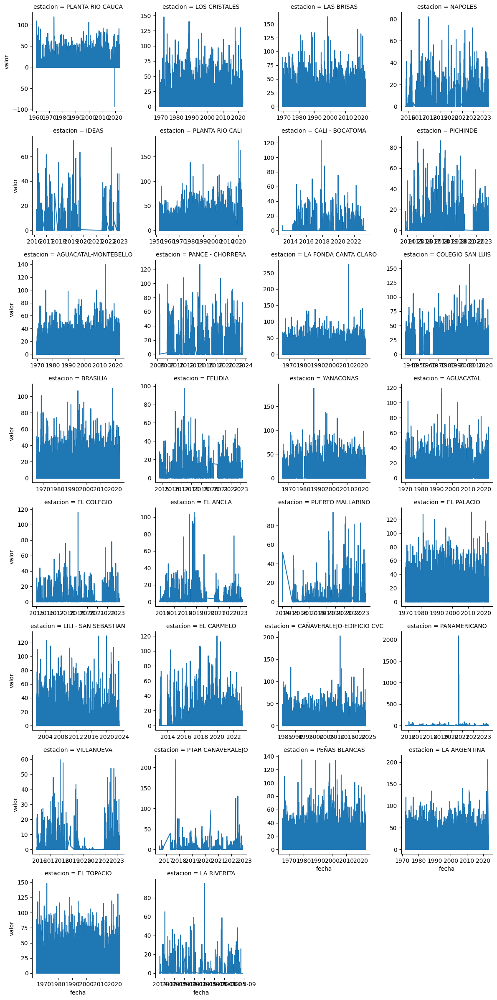

In [ ]:
def make_matrix_plot(df, x, y, hue):
    # Create a matrix plot of the specified columns, with subplots for each category in 'hue'.
    g = sns.FacetGrid(df, col=hue, col_wrap=4, sharex=False, sharey=False)
    g.map(sns.lineplot, x, y)
    plt.show()

make_matrix_plot(df, 'fecha', 'valor', 'estacion')

# CREACIÓN DE DATASET INICIAL PARA EDA:

A partir de este punto se crea la versión "raw" o preliminar del dataset que se usará para el entrenamiento, los siguientes procesos que se aplicarán son:
1. Preprocesamiento de datos (refinamiento)
2. Feature engineering a partir de shap_values,
3. Análisis exploratorio de los datos.

Se ha seleccionado para continuar el desarrollo, los datos provenientes de la estación Seleccionada

## Verificación del tipo de datos

In [ ]:
# Group by 'estacion' and count the number of unique dates
date_ranges = df.groupby('estacion')['fecha'].nunique()

# Find the station with the maximum date range
station_with_max_range = date_ranges.idxmax()

print(f"La estación con mayor rango de fechas es: {station_with_max_range}")

La estación con mayor rango de fechas es: COLEGIO SAN LUIS


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 345988 entries, 0 to 345987
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   estacion  345988 non-null  object        
 1   fecha     345988 non-null  datetime64[ns]
 2   valor     345988 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 7.9+ MB


In [ ]:
df

,estacion,fecha,valor
0,PLANTA RIO CAUCA,1960-03-20,3.0
1,PLANTA RIO CAUCA,1960-03-21,20.0
2,PLANTA RIO CAUCA,1960-03-22,22.0
3,PLANTA RIO CAUCA,1960-03-23,2.0
4,PLANTA RIO CAUCA,1960-03-24,2.0
...,...,...,...
345983,LA RIVERITA,2019-08-12,0.0
345984,LA RIVERITA,2019-08-13,0.0
345985,LA RIVERITA,2019-08-14,0.0
345986,LA RIVERITA,2019-08-15,0.0


In [ ]:
print("La dimensionalidad del dataframe es: ", df.shape)

La dimensionalidad del dataframe es:  (345988, 3)


In [ ]:
# Filter the DataFrame to include only data for the "AGUACATAL-MONTEBELLO" station.
df = df[df['estacion'] == 'AGUACATAL-MONTEBELLO']

In [ ]:
#Función para encontrar las fechas faltantes en df

def find_missing_dates(df):
  # Create a complete date range for the station
  min_date = df['fecha'].min()
  max_date = df['fecha'].max()
  complete_date_range = pd.date_range(start=min_date, end=max_date, freq='D')

  # Find the missing dates
  missing_dates = complete_date_range.difference(df['fecha'])

  if missing_dates.empty:
    print("No hay fechas faltantes.")
  else:
    print("Fechas faltantes:")
    print(missing_dates)

  return missing_dates

In [ ]:
missing_dates = find_missing_dates(df)

Fechas faltantes:
DatetimeIndex(['1969-12-30', '1977-09-30', '1992-10-31', '2007-03-26',
               '2007-08-31', '2009-01-13', '2011-06-30', '2011-07-31',
               '2011-12-31', '2013-04-30', '2013-06-30', '2013-09-30',
               '2020-05-30'],
              dtype='datetime64[ns]', freq=None)


In [ ]:
df.shape

(19500, 3)

## Verificación del tipo de datos al convertir las fechas

In [ ]:
dia = 19499  # Example index, adjust as needed

# Check if 'dia' is still a valid index after removing rows with invalid dates
if dia < len(df):
    # Access the datetime object for the specified row
    date_time_obj = df.fecha.iloc[dia]

    # Extract minute information
    minute_of_hour = date_time_obj.minute

    print(f"""fecha: {date_time_obj}
          Day of year: {df.fecha.dt.dayofyear.iloc[dia]}
          Day of week: {df.fecha.dt.dayofweek.iloc[dia]}
          Month: {df.fecha.dt.month.iloc[dia]}
          Month Name: {df.fecha.dt.month_name().iloc[dia]}
          Quarter: {df.fecha.dt.quarter.iloc[dia]}
          Year: {df.fecha.dt.year.iloc[dia]}
          ISO Week: {df.fecha.dt.isocalendar().week.iloc[dia]}
          Minute of the hour: {minute_of_hour}""")
else:
    print(f"Index {dia} is out of bounds after removing invalid dates. The maximum valid index is {len(df)-1}")

fecha: 2022-11-09 00:00:00
          Day of year: 313
          Day of week: 2
          Month: 11
          Month Name: November
          Quarter: 4
          Year: 2022
          ISO Week: 45
          Minute of the hour: 0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19500 entries, 93982 to 113481
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   estacion  19500 non-null  object        
 1   fecha     19500 non-null  datetime64[ns]
 2   valor     19500 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 609.4+ KB


In [ ]:
# Filter the DataFrame to include only data for the "AGUACATAL-MONTEBELLO" station.
df = df[df['estacion'] == 'AGUACATAL-MONTEBELLO']

In [ ]:
df = df.drop(['estacion'], axis=1)

In [ ]:
# Esta porción de código intercambia las posiciones de las columnas "fecha" con "dato_sensor"
cols = df.columns.tolist()
a, b = cols.index('fecha'), cols.index('valor')
cols[b], cols[a] = cols[a], cols[b]
df = df[cols]
df.head()

,valor,fecha
93982,0.0,1969-07-09
93983,10.0,1969-07-10
93984,0.0,1969-07-11
93985,0.0,1969-07-12
93986,0.0,1969-07-13


In [ ]:
df_ff=df

In [ ]:
def set_date_as_index(df):
  """Sets the 'Date' column as the index of the DataFrame.

  Args:
    df: The input DataFrame.

  Returns:
    A new DataFrame with the 'Date' column as the index, or the original
    DataFrame if 'Date' column is not found or not of datetime type.
  """
  if 'fecha' not in df.columns:
    print("Error: 'Date' column not found in the DataFrame.")
    return df

  if not pd.api.types.is_datetime64_any_dtype(df['fecha']):
      print("Error: 'Fecha' column is not of datetime type.")
      return df

  df = df.set_index('fecha')
  return df

# Example usage with df DataFrame
df_ff = set_date_as_index(df_ff)
df_ff.head()

,valor
fecha,
1969-07-09,0.0
1969-07-10,10.0
1969-07-11,0.0
1969-07-12,0.0
1969-07-13,0.0


## Verificación de duplicidad en datos

In [ ]:
df_ff.duplicated().any()

True

In [ ]:
# Check for duplicates in the DataFrame
duplicates = df_ff[df_ff.duplicated(keep=False)]

if not duplicates.empty:
    print("Duplicate rows found:")
    print(duplicates)
else:
    print("No duplicate rows found.")

Duplicate rows found:
            valor
fecha            
1969-07-09    0.0
1969-07-10   10.0
1969-07-11    0.0
1969-07-12    0.0
1969-07-13    0.0
...           ...
2022-11-05    0.0
2022-11-06    0.0
2022-11-07    3.0
2022-11-08    7.0
2022-11-09    2.0

[19486 rows x 1 columns]


In [ ]:
df_ff.index.isna().sum()

0

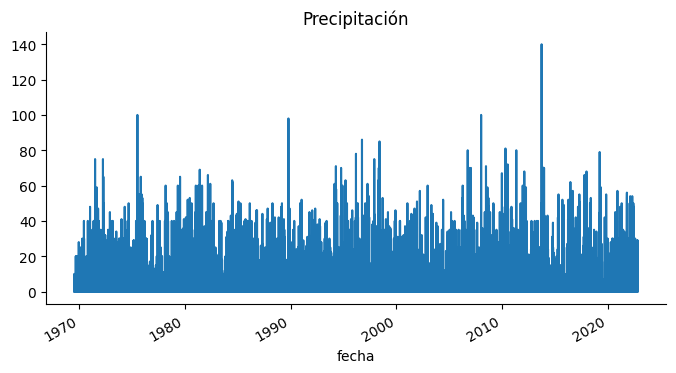

In [ ]:
df_ff['valor'].plot(kind='line', figsize=(8, 4), title='Precipitación')
plt.gca().spines[['top', 'right']].set_visible(False)

In [ ]:
df_ff.groupby(df_ff.index.month).describe()

valor                                                
        count      mean        std  min  25%  50%  75%    max
fecha                                                        
1      1673.0  2.481769   7.293066  0.0  0.0  0.0  0.0  100.0
2      1497.0  2.783567   7.259692  0.0  0.0  0.0  1.0   68.0
3      1642.0  3.964068   9.216896  0.0  0.0  0.0  3.0   79.0
4      1589.0  5.813090  11.091885  0.0  0.0  0.0  7.0   81.0
5      1642.0  4.754568   9.706544  0.0  0.0  0.0  5.0   85.0
6      1588.0  2.976071   8.517268  0.0  0.0  0.0  1.0  100.0
7      1665.0  1.690090   5.947592  0.0  0.0  0.0  0.0   72.0
8      1673.0  1.769277   5.982977  0.0  0.0  0.0  0.0   60.0
9      1618.0  3.108776   8.542768  0.0  0.0  0.0  1.0  140.0
10     1673.0  4.195457   9.114210  0.0  0.0  0.0  5.0   98.0
11     1599.0  4.406191   8.878771  0.0  0.0  0.0  5.0   75.0
12     1641.0  2.822669   7.790371  0.0  0.0  0.0  1.0   70.0

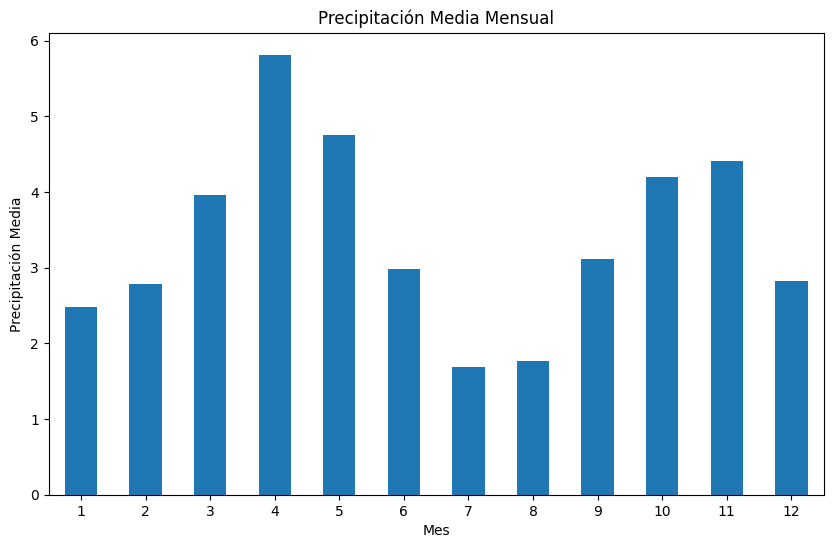

In [ ]:
# Group data by month and describe
monthly_stats = df_ff.groupby(df_ff.index.month).describe()

# Plot the results
monthly_stats['valor']['mean'].plot(kind='bar', figsize=(10, 6))
plt.title('Precipitación Media Mensual')
plt.xlabel('Mes')
plt.ylabel('Precipitación Media')
plt.xticks(rotation=0)  # Rotate x-axis labels for better readability
plt.show()

In [ ]:
df_ff.groupby(df_ff.index.day).describe()

valor                                                
       count      mean        std  min  25%  50%  75%    max
fecha                                                       
1      641.0  3.759750   8.981665  0.0  0.0  0.0  3.0   80.0
2      641.0  3.176287   7.864584  0.0  0.0  0.0  2.0   66.0
3      641.0  3.282371   8.175792  0.0  0.0  0.0  2.0   70.0
4      641.0  3.469579   8.532260  0.0  0.0  0.0  3.0   60.0
5      641.0  3.739470   9.058792  0.0  0.0  0.0  2.0   78.0
6      641.0  3.266771   7.259841  0.0  0.0  0.0  3.0   59.0
7      641.0  3.196568   7.424961  0.0  0.0  0.0  2.0   49.0
8      641.0  3.700468   9.702488  0.0  0.0  0.0  3.0  100.0
9      642.0  3.130841   7.921712  0.0  0.0  0.0  2.0   70.0
10     641.0  3.101404   8.034925  0.0  0.0  0.0  1.0   63.0
11     641.0  3.028081   8.143008  0.0  0.0  0.0  2.0   71.0
12     641.0  3.266771   8.412731  0.0  0.0  0.0  2.0   60.0
13     640.0  3.804688   9.403042  0.0  0.0  0.0  2.0   72.0
14     641.0  3.283931   8.287069  0.0  0.0  0.0  2.0   98.0
15     641.0  2.854914   7.194345  0.0  0.0  0.0  1.0   60.0
16     641.0  3.692668   8.998998  0.0  0.0  0.0  2.0   71.0
17     641.0  3.149922   7.295333  0.0  0.0  0.0  2.0   52.0
18     641.0  3.638846   8.762103  0.0  0.0  0.0  2.0   66.0
19     641.0  3.277535   8.421349  0.0  0.0  0.0  2.0   63.0
20     641.0  3.435257   8.250337  0.0  0.0  0.0  3.0   70.0
21     641.0  3.012480   7.391285  0.0  0.0  0.0  1.0   53.0
22     641.0  2.659906   7.607342  0.0  0.0  0.0  1.0   70.0
23     641.0  3.039002   7.862095  0.0  0.0  0.0  1.0   69.0
24     641.0  3.330733   8.686186  0.0  0.0  0.0  2.0   71.0
25     641.0  3.906396   8.928044  0.0  0.0  0.0  3.0   67.0
26     640.0  3.287500   7.886827  0.0  0.0  0.0  3.0   75.0
27     641.0  3.552262   8.687860  0.0  0.0  0.0  2.0   60.0
28     641.0  4.556942  12.423653  0.0  0.0  0.0  2.0  140.0
29     601.0  3.261231   7.927377  0.0  0.0  0.0  3.0   86.0
30     581.0  3.600688   8.993039  0.0  0.0  0.0  2.0  100.0
31     371.0  3.803235   8.543155  0.0  0.0  0.0  3.0   55.0

# **1. Estacionariedad**
Una serie de tiempo es estacionaria si sus propiedades estadísticas, como la media, la varianza y la autocorrelación, se mantienen constantes a lo largo del tiempo. Es decir, una serie estacionaria no muestra tendencias ni cambios estacionales evidentes.

## **Características de una serie estacionaria:**
**Media constante:** La serie oscila alrededor de un nivel medio constante.
Varianza constante: Las amplitudes de las fluctuaciones son similares a lo largo del tiempo.

**Autocorrelación constante:** La relación entre los valores de la serie no cambia con el tiempo.

**Importancia:**

Muchas técnicas estadísticas y modelos de series de tiempo, como ARIMA, asumen estacionariedad.
Si la serie no es estacionaria, primero se deben aplicar transformaciones (como diferenciación o eliminación de tendencia).
## **Cómo verificar estacionariedad:**
**Prueba de Dickey-Fuller Aumentada (ADF):** Test estadístico para verificar si una serie tiene una raíz unitaria (indicando no estacionariedad).

**Visualización:** Observar si hay tendencias o cambios en la amplitud.

**Gráfico de autocorrelación (ACF):** Una serie estacionaria tiende a tener una autocorrelación decreciente rápidamente.

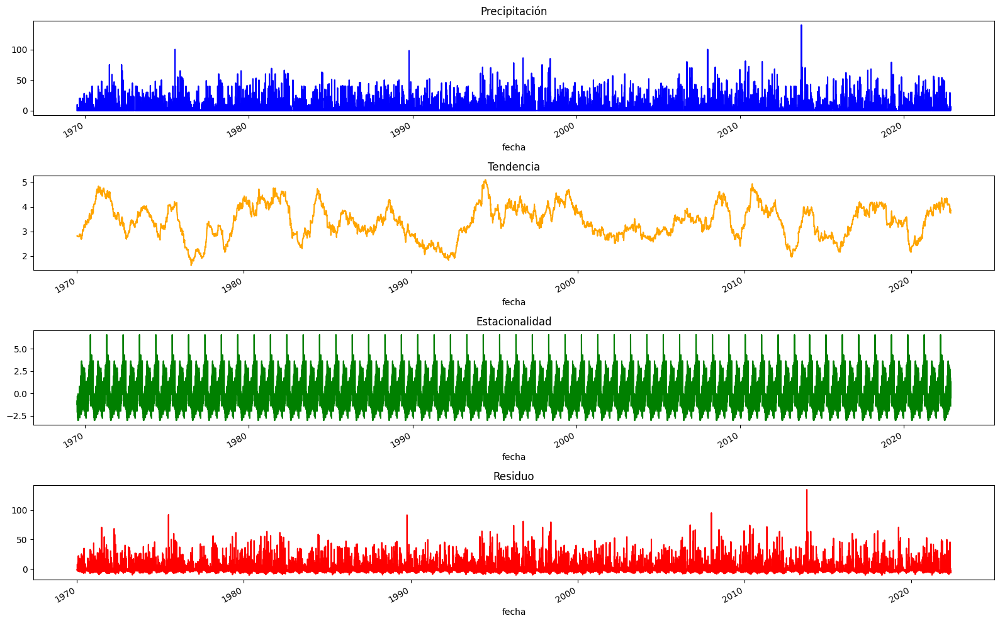

In [ ]:
df_ts = sm.tsa.seasonal_decompose(df_ff, model='additive', period=365)

# Crear una figura de mayor tamaño
fig, axes = plt.subplots(4, 1, figsize=(16, 10))  # Ajusta el tamaño según sea necesario

# Graficar cada componente en un subgráfico específico
df_ts.observed.plot(ax=axes[0], title='Precipitación', color='blue')
df_ts.trend.plot(ax=axes[1], title='Tendencia', color='orange')
df_ts.seasonal.plot(ax=axes[2], title='Estacionalidad', color='green')
df_ts.resid.plot(ax=axes[3], title='Residuo', color='red')

# Ajustar el espacio entre subgráficos
plt.tight_layout()
plt.show()

# **2. Estacionalidad**
La estacionalidad se refiere a los patrones repetitivos o cíclicos que ocurren en intervalos de tiempo regulares. Estos patrones suelen estar relacionados con factores temporales como estaciones del año, meses, días de la semana, o incluso horas del día.

## **Ejemplos:**
- Ventas de helados que aumentan en verano.

- Incrementos en el consumo eléctrico durante el invierno.

- Tráfico en redes sociales que es más alto durante ciertos días de la semana.

**Características de una serie estacional:**

- Tiene un componente cíclico definido y recurrente.

- El período del ciclo es fijo (por ejemplo, 12 meses para datos anuales, 7 días para datos semanales).

- Puede superponerse a una tendencia general (creciente o decreciente).

**Cómo detectar estacionalidad:**

**Visualización:** Observa los gráficos de la serie para identificar patrones regulares.

**Descomposición de series de tiempo:** Separa la serie en componentes como tendencia, estacionalidad y residuo (ruido). Esto se puede hacer con métodos como seasonal_decompose.

**Espectro de Fourier:** Ayuda a identificar frecuencias dominantes en los datos.

In [ ]:
# Pass the 'observed' attribute, which contains the original time series data:
result = adfuller(df_ff, autolag='AIC')
print(f'ADF Statistic: {result[0]}')
print(f'p-value: {result[1]}')
print(f'n_lags: {result[2]}')
for key, value in result[4].items():
    print('Critial Values:')
    print(f'   {key}, {value}')
    if result[0] <= value:
      print("Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.")
    else:
      print("Weak evidence aganist Null Hypothesis. So, accept Null Hypothesis and conclude data is non-stationary.")

ADF Statistic: -17.750974764183407
p-value: 3.3701415871466074e-30
n_lags: 43
Critial Values:
   1%, -3.430686151468807
Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.
Critial Values:
   5%, -2.861688566906097
Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.
Critial Values:
   10%, -2.56684907814438
Strong evidence aganist Null Hypothesis. So, reject Null Hypothesis and conclude data is stationary.


# Funciones de Autocorrelación y Autocorrelación parcial

In [ ]:
# Crear una figura y un conjunto de ejes con un tamaño de 20x5 pulgadas para el gráfico
fig, ax = plt.subplots(figsize=(20,5))
plot_acf(df_ff, lags=365, auto_ylims=True, ax=ax)


NameError: name 'plt' is not defined

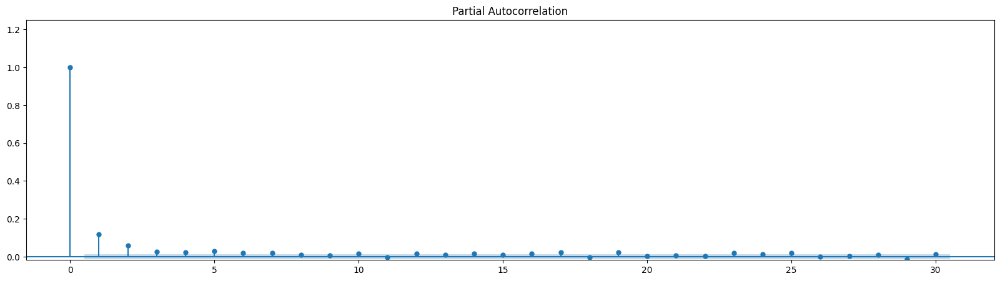

In [ ]:
fig, ax = plt.subplots(figsize=(20,5))
# Graficar la función de autocorrelación parcial (PACF) para los datos en 'df_ff', con rezagos hasta 30
plot_pacf(df_ff, lags=30, auto_ylims=True, ax=ax);

In [ ]:
# Crear un perfil de reporte exploratorio de datos (EDA) para la serie temporal 'df', con la opción tsmode activada
profile = ProfileReport(df, tsmode=True, title="Serie de Tiempo - Precipitación Media Mensual")
# Guardar el reporte como un archivo HTML con el nombre especificado
profile.to_file("REPORTE EDA: AGUACATAL-MONTEBELLO.html")

NameError: name 'ProfileReport' is not defined

In [ ]:
# Obtener la fecha mínima (primera fecha) y fecha maxima en el índice de df_ff
first_date = df_ff.index.min()
last_date = df_ff.index.max()

# Imprimir la primera y última fecha del índice
print(f"First date: {first_date}")
print(f"Last date: {last_date}")

First date: 1969-07-09 00:00:00
Last date: 2022-11-09 00:00:00


# **Funciones para el entrenamiento de modelos:**

In [ ]:
# Definir el tamaño de la ventana (número de períodos previos) para un modelo de series temporales
window = 6
# Definir el horizonte de predicción (cuántos períodos hacia adelante se va a predecir)
horizon = 1

In [ ]:
def partir_dataframe(df, fin_train, inicio_prueba):
# Asigna las fechas de corte para el conjunto de entrenamiento y de prueba
  fin_train = fin_train #'2015-07-18 00:00:00' # Fecha final del conjunto de entrenamiento
  inicio_prueba = inicio_prueba #'2015-07-19 00:00:00' # Fecha inicial del conjunto de prueba,
  df_train, df_test = df.loc[: fin_train], df.loc[inicio_prueba:]     # Divide el DataFrame en dos partes: entrenamiento (df_train) y prueba (df_test)
  # Obtiene el tamaño de cada conjunto (número de filas) y lo guarda en 'train_size' y 'test_size'
  train_size, test_size = df_train.shape[0], df_test.shape[0]
  print(f"Fechas train      : {df_train.index.min()} --- {df_train.index.max()}")
  print(f"Fechas test       : {df_test.index.min()} --- {df_test.index.max()}")

# Retorna los DataFrames separados: entrenamiento y prueba
  return df_train, df_test

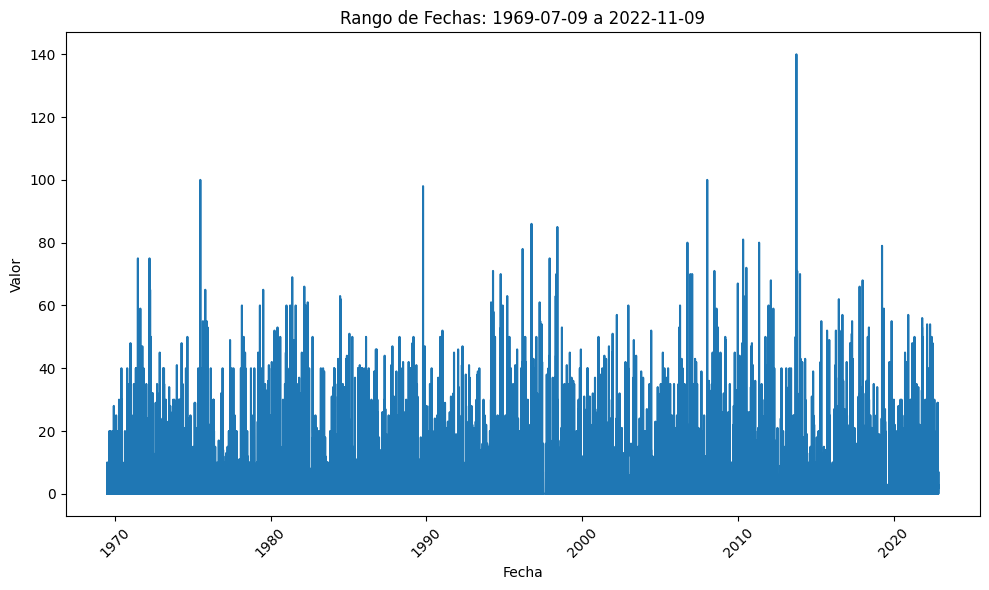

In [ ]:
def plot_date_range(df, start_date, end_date):
    """Plots the 'valor' column of df_ff within the specified date range."""

    # Convert input strings to datetime objects
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)

    # Filter the DataFrame based on the date range
    filtered_df = df[(df.index >= start_date) & (df.index <= end_date)]

    # Create the plot
    plt.figure(figsize=(10, 6))
    plt.plot(filtered_df.index, filtered_df['valor'])
    plt.xlabel("Fecha")
    plt.ylabel("Valor")
    plt.title(f"Rango de Fechas: {start_date.strftime('%Y-%m-%d')} a {end_date.strftime('%Y-%m-%d')}")
    plt.xticks(rotation=45)
    plt.tight_layout()  # Adjust layout to prevent labels from overlapping
    plt.show()


# Example usage
plot_date_range(df_ff, '1969-07-09 00:00:00', '2022-11-09 00:00:00') # replace with your desired dates

In [ ]:
# Crear una copia del DataFrame original 'df_ff' para no modificar el original
df_ff_keras = df_ff.copy()
#scaler_keras = StandardScaler()
scaler_keras = MinMaxScaler(feature_range=(0,1)) # Usar MinMaxScaler para escalar los valores de la columna 'valor' al rango [0, 1]
# Aplicar la transformación MinMaxScaler a la columna 'valor' y guardar los valores escalados en la misma columna
df_ff_keras['valor'] = scaler_keras.fit_transform(df_ff[['valor']].values)
df_ff_keras

,valor
fecha,
1969-07-09,0.000000
1969-07-10,0.071429
1969-07-11,0.000000
1969-07-12,0.000000
1969-07-13,0.000000
...,...
2022-11-05,0.000000
2022-11-06,0.000000
2022-11-07,0.021429


In [ ]:
df_train, df_test=partir_dataframe(df_ff_keras, '2012-03-09 00:00:00', '2012-03-10 00:00:00')

Fechas train      : 1969-07-09 00:00:00 --- 2012-03-09 00:00:00
Fechas test       : 2012-03-10 00:00:00 --- 2022-11-09 00:00:00


In [ ]:
#Esta función toma una serie temporal y la transforma en un formato adecuado para modelos supervisados, generando entradas (features) y salidas (targets) a partir de los desplazamientos temporales de los datos.
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    df = pd.DataFrame(data)
    n_vars = df.shape[1] if hasattr(df, 'shape') else 1
    cols = [df.shift(i) for i in range(n_in, 0, -1)] + [df.shift(-i) for i in range(n_out)]
    names = [f'var{j+1}(t{"+" if i > 0 else ""}{i})' for i in range(-n_in, n_out) for j in range(n_vars)]
    agg = pd.concat(cols, axis=1)
    agg.columns = names[:agg.shape[1]]
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [ ]:
#La función train_split toma los conjuntos de datos de entrenamiento y prueba, los convierte en formato supervisado utilizando ventanas de tiempo (para las entradas) y horizontes de tiempo (para las salidas), y luego los divide en características y etiquetas
def train_split(df_train, df_test, window, horizon):
  train, test = series_to_supervised(df_train, window, horizon), series_to_supervised(df_test, window, horizon)
  print(train.shape, test.shape)
  X_train, X_test = train.values[:, 0:window], test.values[:, 0:window]
  y_train, y_test = train.values[:, window:], test.values[:, window:]
  print("--------\nEntrenamiento:",X_train.shape, y_train.shape,"\nPrueba:", X_test.shape, y_test.shape)
  return X_train, X_test, y_train, y_test

In [ ]:
window = 6
horizon = 1

In [ ]:
X_train, X_test, y_train, y_test=train_split(df_train, df_test, window, horizon)

(15570, 7) (3918, 7)
--------
Entrenamiento: (15570, 6) (15570, 1) 
Prueba: (3918, 6) (3918, 1)


# **1. Modelo de Keras con Capas Densas**

In [ ]:
#Este código define y compila un modelo de red neuronal profunda en Keras para predicción de series temporales,
#con regularización L2 y abandono para prevenir el sobreajuste. Se utiliza la GPU para acelerar el entrenamiento, y el modelo se entrena con el optimizador Adam y una función de pérdida MSE adecuada para regresión

# Especificar que se debe usar la GPU para entrenar el modelo
with tf.device('/GPU:0'):
    modelo = keras.models.Sequential()
    modelo.add(keras.layers.Dense(64, input_shape=(X_train.shape[1],), activation='relu',
                                  kernel_regularizer=regularizers.l2(0.01)))
    modelo.add(BatchNormalization())
    modelo.add(Dropout(0.2))

    modelo.add(keras.layers.Dense(32, activation='relu', kernel_regularizer=regularizers.l2(0.01)))
    modelo.add(BatchNormalization())
    modelo.add(Dropout(0.2))

    modelo.add(keras.layers.Dense(horizon, activation='linear'))

    modelo.compile(optimizer=keras.optimizers.Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
    modelo.summary()


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_12 (Dense)                     │ (None, 64)                  │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 32)                  │           2,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 32)                  │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,945 (11.50 KB)

 Trainable params: 2,753 (10.75 KB)

 Non-trainable params: 192 (768.00 B)

In [ ]:
# entrena un modelo de red neuronal utilizando el optimizador AdamW,
#con un enfoque en la prevención del sobreajuste y la mejora del rendimiento a través de callbacks.
#Estos incluyen el guardado del mejor modelo, detención temprana y ajuste dinámico de la tasa de aprendizaje,
#todo mientras se realiza la validación del modelo con un 20% de los datos de entrenamiento y se entrena durante un máximo de 50 épocas.
%%time
from random import seed
callbacks = [call.ModelCheckpoint(filepath='model.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=5, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 2, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo.compile('adamw','mse', metrics=['mse'])
historia = modelo.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=50,verbose=1,
                      callbacks=callbacks,shuffle=True,)

Epoch 1/50
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 1.1425 - mse: 0.6769
Epoch 1: val_loss improved from inf to 0.35969, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 8s 9ms/step - loss: 1.1417 - mse: 0.6763 - val_loss: 0.3597 - val_mse: 0.0168 - learning_rate: 0.0010
Epoch 2/50
377/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.4262 - mse: 0.1088
Epoch 2: val_loss improved from 0.35969 to 0.24922, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4244 - mse: 0.1079 - val_loss: 0.2492 - val_mse: 0.0051 - learning_rate: 0.0010
Epoch 3/50
363/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.2618 - mse: 0.0369
Epoch 3: val_loss improved from 0.24922 to 0.17176, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2597 - mse: 0.0362 - val_loss: 0.1718 - val_mse: 0.0043 - learning_rate: 0.0010
Epoch 4/50
381/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.1629 - mse: 0.0107
Epoch 4: val_loss improved from 

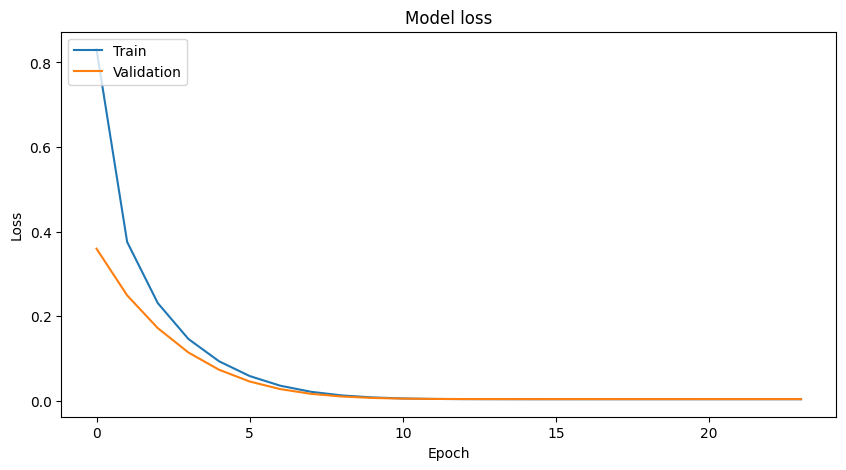

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(10, 5))
plt.plot(historia.history['loss'])
plt.plot(historia.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


In [ ]:
model = mod.load_model('model.best.keras')
predictions = model.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


In [ ]:
#X_test

In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions))*100)
#print("R2:", r2_score(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))

RMSE: 8.49908448032754
MAE: 4.919761620595055
MAPE: 1.0625503515299249e+18


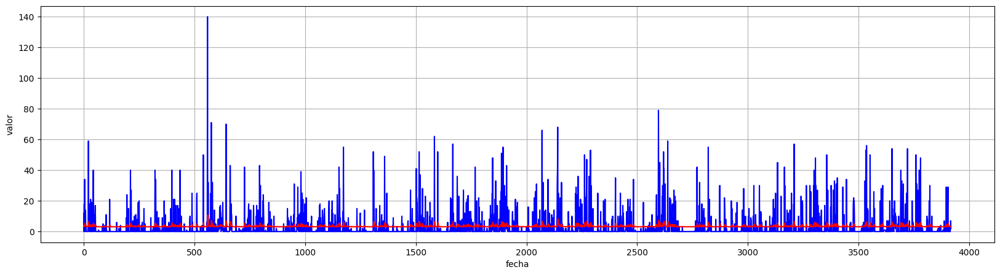

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions),'r')
plt.grid('on')
plt.ylabel('valor')
plt.xlabel("fecha");

In [ ]:
prueba_xtest=scaler_keras.inverse_transform(y_test)

In [ ]:
prueba_modDense=scaler_keras.inverse_transform(predictions)

In [ ]:
prueba_xtest

array([[12.],
       [ 0.],
       [18.],
       ...,
       [ 3.],
       [ 7.],
       [ 2.]])

In [ ]:
prueba_modDense

array([[3.286683 ],
       [3.8232088],
       [3.4688456],
       ...,
       [3.1261954],
       [3.2812133],
       [3.5718832]], dtype=float32)

# **2. Modelo de Redes Neuronales Convolucionales 1D - CNN Conv1D:**

In [ ]:
#Division del Dataframe en una parte para entrenamiento y otra para la prueba
conv_train, conv_test=partir_dataframe(df_ff_keras, '2012-03-09 00:00:00', '2012-03-10 00:00:00')

Fechas train      : 1969-07-09 00:00:00 --- 2012-03-09 00:00:00
Fechas test       : 2012-03-10 00:00:00 --- 2022-11-09 00:00:00


In [ ]:
window = 6
horizon = 1

In [ ]:
X_trainConv, X_testConv, y_trainConv, y_test=train_split(conv_train, conv_test, window, horizon)

(15570, 7) (3918, 7)
--------
Entrenamiento: (15570, 6) (15570, 1) 
Prueba: (3918, 6) (3918, 1)


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv1d_81 (Conv1D)                   │ (None, 6, 16)               │             720 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_82 (Conv1D)                   │ (None, 6, 32)               │          22,560 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_29 (MaxPooling1D)      │ (None, 6, 32)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_37               │ (None, 6, 32)               │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_27 (Flatten)                 │ (None, 192)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_75 (Dense)                     │ (None, 12)                  │           2,316 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_33 (Dropout)                 │ (None, 12)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_76 (Dense)                     │ (None, 1)                   │              13 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 25,737 (100.54 KB)

 Trainable params: 25,673 (100.29 KB)

 Non-trainable params: 64 (256.00 B)

CPU times: user 153 ms, sys: 5.52 ms, total: 159 ms
Wall time: 438 ms


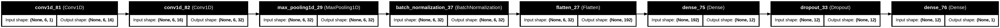

In [ ]:
"""
Se define una red neuronal convolucional 1D para procesar datos secuenciales.
Se utiliza Leaky ReLU como función de activación, y se implementan técnicas como normalización por lotes,
MaxPooling, regularización L2 y Dropout para prevenir el sobreajuste y mejorar la generalización del modelo.
El tamaño de las secuencias de entrada se define con la variable window, y la red tiene una arquitectura más compleja para captar patrones en los datos.
"""
%%time


import keras
keras.utils.set_random_seed(42)
modelo = keras.models.Sequential()
modelo.add(keras.layers.Conv1D(16, 44, activation="leaky_relu",padding="same", input_shape=(window,1)))
modelo.add(keras.layers.Conv1D(32, 44, activation="leaky_relu", padding='same'))  # Reduced kernel size and added padding
modelo.add(keras.layers.MaxPooling1D(pool_size=3,strides=1, padding='same'))
modelo.add(keras.layers.BatchNormalization())
modelo.add(keras.layers.Flatten())
modelo.add(keras.layers.Dense(12, activation = 'leaky_relu', kernel_regularizer=keras.regularizers.l2(0.0001)))
modelo.add(keras.layers.Dropout(0.3))  # Reduce el sobreajuste


modelo.add(keras.layers.Dense(horizon, activation = 'linear'))
# Se muestra el resumen de la arquitectura del modelo
modelo.summary()
# Se muestra un esquema del modelo
keras.utils.plot_model(modelo, to_file='model_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='model.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=10, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 2, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo.compile('adam','huber', metrics=['mse'])
historia = modelo.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=50,verbose=1,
                      callbacks=callbacks,shuffle=True)

Epoch 1/50
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0039 - mse: 0.0044
Epoch 1: val_loss improved from inf to 0.00244, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - loss: 0.0039 - mse: 0.0044 - val_loss: 0.0024 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 2/50
386/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0022 - mse: 0.0038
Epoch 2: val_loss improved from 0.00244 to 0.00201, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step - loss: 0.0022 - mse: 0.0038 - val_loss: 0.0020 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 3/50
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0020 - mse: 0.0038
Epoch 3: val_loss improved from 0.00201 to 0.00193, saving model to model.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0020 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 4/50
372/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0019 - mse: 0.0038
Epoch 4: val_loss did not improv

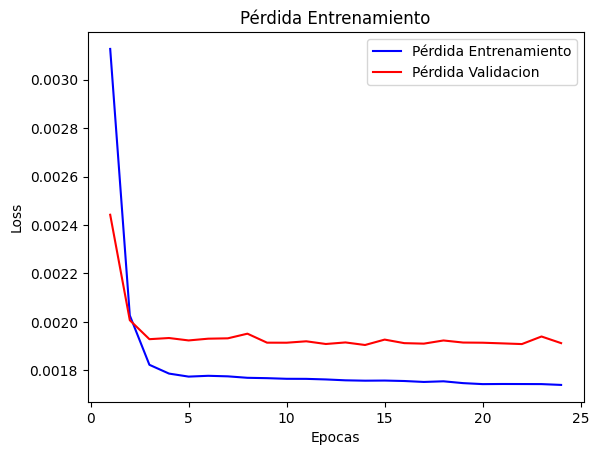

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model = mod.load_model('model.best.keras')
predictions = model.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions))*100)
#print("R2:", r2_score(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions)))

RMSE: 8.466651675807329
MAE: 4.68344010228159
MAPE: 9.477399652839162e+17


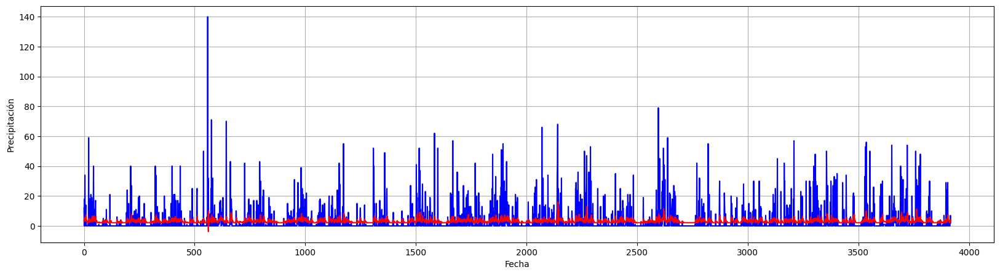

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

In [ ]:
prueba_xtest

array([[12.],
       [ 0.],
       [18.],
       ...,
       [ 3.],
       [ 7.],
       [ 2.]])

In [ ]:
prueba_modConv=scaler_keras.inverse_transform(predictions)

In [ ]:
prueba_modConv

array([[3.7413156],
       [5.994584 ],
       [3.3286507],
       ...,
       [2.4382977],
       [3.8193521],
       [5.0376105]], dtype=float32)

# **TCN - STUDY //// CAMBIAR ESTE TITULO**

In [ ]:
!pip install -q -U darts
!pip install -q -U optuna
!pip install -q optuna-integration[pytorch_lightning]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.8/165.8 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 934.2/934.2 kB 23.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 60.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 44.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.1/319.1 kB 23.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.6/275.6 kB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 42.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.7/41.7 kB 3.3 MB/s eta 0:00:0

In [ ]:
import optuna
from optuna.integration import PyTorchLightningPruningCallback
from optuna.visualization import (
    plot_optimization_history,
    plot_contour,
    plot_param_importances,
)

from darts import TimeSeries, concatenate
from darts.utils.callbacks import TFMProgressBar
from darts.models import TCNModel
from darts.dataprocessing.transformers import Scaler
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.metrics import mape, r2_score, rmse, mae, smape
from pytorch_lightning.callbacks import Callback, EarlyStopping
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.optim import Adam
from torch.nn import HuberLoss, SmoothL1Loss

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning:


Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.




In [ ]:
ST_Lluv = df_ff.reset_index()

In [ ]:
'''ST_Lluv = ST_Lluv.interpolate(method='linear')
ST_Lluv'''

"ST_Lluv = ST_Lluv.interpolate(method='linear')\nST_Lluv"

In [ ]:
ST_Lluv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19500 entries, 0 to 19499
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   fecha   19500 non-null  datetime64[ns]
 1   valor   19500 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 304.8 KB


In [ ]:
# Set 'fecha' column as the index
ST_Lluv = ST_Lluv.set_index('fecha')

# Ensure 'fecha' is of datetime type
ST_Lluv.index = pd.to_datetime(ST_Lluv.index)

# Resample to daily frequency and take the sum
ST_Lluv_daily = ST_Lluv.resample('D').sum()

# Display the daily data
ST_Lluv_daily

,valor
fecha,
1969-07-09,0.0
1969-07-10,10.0
1969-07-11,0.0
1969-07-12,0.0
1969-07-13,0.0
...,...
2022-11-05,0.0
2022-11-06,0.0
2022-11-07,3.0


In [ ]:
# Reset the index to make 'fecha' a column again
ST_Lluv_daily = ST_Lluv_daily.reset_index()

# Convert 'fecha' to datetime
ST_Lluv_daily['fecha'] = pd.to_datetime(ST_Lluv_daily['fecha'])

# Set 'fecha' as the index again
ST_Lluv_daily.set_index('fecha', inplace=True, drop=True)

print("Frecuencia Antes: ",ST_Lluv_daily.index.freq)

# Ensure daily frequency
ST_Lluv_daily = ST_Lluv_daily.asfreq('D')

print("Frecuencia Despues: ",ST_Lluv_daily.index.freq)

Frecuencia Antes:  None
Frecuencia Despues:  <Day>


In [ ]:
ST_Lluv_daily=ST_Lluv_daily.reset_index()

In [ ]:
ST_Lluv_daily

,fecha,valor
0,1969-07-09,0.0
1,1969-07-10,10.0
2,1969-07-11,0.0
3,1969-07-12,0.0
4,1969-07-13,0.0
...,...,...
19477,2022-11-05,0.0
19478,2022-11-06,0.0
19479,2022-11-07,3.0
19480,2022-11-08,7.0


In [ ]:
ST_Lluv_daily = TimeSeries.from_dataframe(ST_Lluv_daily,'fecha', "valor")
ST_train_val, ST_test = ST_Lluv_daily.split_after(pd.Timestamp('20150718'))
ST_train, ST_val = ST_train_val.split_after(0.8)

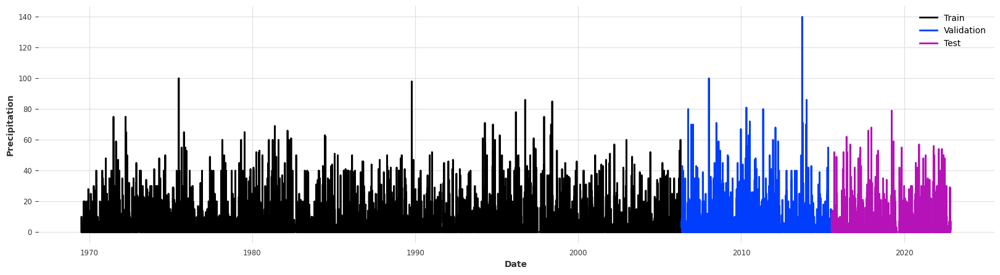

In [ ]:
plt.figure(figsize=(20, 5))
ST_train.plot(label='Train'),ST_val.plot(label='Validation'),ST_test.plot(label='Test')
plt.ylabel('Precipitation')
plt.xlabel("Date");

In [ ]:
scaler = Scaler(scaler_keras)
train_scaled = scaler.fit_transform(ST_train)
test_scaled = scaler.transform(ST_test)
val_scaled = scaler.transform(ST_val)
ts_scaled = scaler.transform(ST_Lluv_daily)

In [ ]:
def build_fit_tcn_model(model_name,wndw,hrzn,kernel_size,num_fil,num_lay,weight_norm,dil_base,dropout,lr,callbacks=None):
  early_stopper = EarlyStopping("val_loss", min_delta=3e-4, patience=10, verbose=True)
  if callbacks is None:
    callbacks = [early_stopper]
  else:
    callbacks = [early_stopper] + callbacks
  pl_k = {"callbacks": callbacks}
  TCN_model = TCNModel(
    input_chunk_length=window, output_chunk_length=horizon, batch_size=32,
    n_epochs=100, dropout=dropout, optimizer_kwargs={"lr": lr},
    dilation_base=dil_base, weight_norm=weight_norm, kernel_size=kernel_size,
    num_filters=num_fil, num_layers=num_lay, random_state=42,
    pl_trainer_kwargs=pl_k, save_checkpoints=True,
    model_name=model_name, loss_fn=HuberLoss(), force_reset=True,
  )
  TCN_model.fit(
    series=train_scaled,
    val_series=val_scaled,
  )
  TCN_model = TCNModel.load_from_checkpoint(model_name=model_name, best=True)
  return TCN_model

In [ ]:
def objective(trial):
  callback = [PyTorchLightningPruningCallback(trial, monitor="val_loss")]
  wind = trial.suggest_int("Forecast_Window", 12, 24)
  ker_size = trial.suggest_int("kernel_size", 3, 5)
  num_filt = trial.suggest_int("num_filters", 5, 25)
  weight_norm = trial.suggest_categorical("weight_norm", [False, True])
  dilat = trial.suggest_int("dilation_base", 1, 4)
  drop = trial.suggest_float("dropout", 0.0, 0.4)
  lr = trial.suggest_float("lr", 5e-5, 1e-3, log=True)

  model_temp = build_fit_tcn_model(
    model_name = "TCN_temp",
    wndw=wind, hrzn=horizon, kernel_size=ker_size,
    num_fil=num_filt, num_lay=2, weight_norm=weight_norm,
    dil_base=dilat, dropout=drop, lr=lr
  )

  backtest = model_temp.historical_forecasts(
    series=ts_scaled,
    start=test_scaled.start_time(),
    forecast_horizon=horizon,
    retrain=False,
    verbose=True,
  )

  test_ts = scaler.inverse_transform(test_scaled)
  back_ts = scaler.inverse_transform(backtest)

  smape_ht = smape(test_ts, back_ts)
  return smape_ht if smape_ht != np.nan else float("inf")

In [ ]:
%%time
def print_callback(study, trial):
    print(f"Current params: {trial.params}") # Print parameters
    # Check if trial has completed before accessing best_value and best_trial
    if trial.state == optuna.trial.TrialState.COMPLETE:
        print(f"Current value: {trial.value}")
        print(f"Best value: {study.best_value}, Best params: {study.best_trial.params}")

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20, callbacks=[print_callback])
print(f"Best value: {study.best_value}, Best params: {study.best_trial.params}")

[I 2024-11-30 05:42:58,831] A new study created in memory with name: no-name-b3fba278-a53c-41d2-a0e5-0b0fa6fc60d4
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollection | 0      | train
4 | val_metrics     | MetricCollection | 0      | train
5 | res_blocks      | ModuleList       | 5.7 K  | train
--------------------------------------------------------

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:43:42,100] Trial 0 finished with value: 166.15963868562943 and parameters: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}. Best is trial 0 with value: 166.15963868562943.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricColl

Current params: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}
Current value: 166.15963868562943
Best value: 166.15963868562943, Best params: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.144


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.103 >= min_delta = 0.0003. New best score: 0.041


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.027 >= min_delta = 0.0003. New best score: 0.014


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.006 >= min_delta = 0.0003. New best score: 0.008


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.002 >= min_delta = 0.0003. New best score: 0.005


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.001 >= min_delta = 0.0003. New best score: 0.005


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:44:44,110] Trial 1 finished with value: 166.5778753058632 and parameters: {'Forecast_Window': 23, 'kernel_size': 4, 'num_filters': 5, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.34049523379597885, 'lr': 0.00011947610881280717}. Best is trial 0 with value: 166.15963868562943.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | crit

Current params: {'Forecast_Window': 23, 'kernel_size': 4, 'num_filters': 5, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.34049523379597885, 'lr': 0.00011947610881280717}
Current value: 166.5778753058632
Best value: 166.15963868562943, Best params: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:45:39,379] Trial 2 finished with value: 166.6611300308615 and parameters: {'Forecast_Window': 15, 'kernel_size': 5, 'num_filters': 24, 'weight_norm': True, 'dilation_base': 4, 'dropout': 0.31597760916179984, 'lr': 0.00011181125352155343}. Best is trial 0 with value: 166.15963868562943.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollec

Current params: {'Forecast_Window': 15, 'kernel_size': 5, 'num_filters': 24, 'weight_norm': True, 'dilation_base': 4, 'dropout': 0.31597760916179984, 'lr': 0.00011181125352155343}
Current value: 166.6611300308615
Best value: 166.15963868562943, Best params: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:46:21,385] Trial 3 finished with value: 166.3543994217903 and parameters: {'Forecast_Window': 23, 'kernel_size': 3, 'num_filters': 24, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.2500273982083024, 'lr': 0.00015713861932957617}. Best is trial 0 with value: 166.15963868562943.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollec

Current params: {'Forecast_Window': 23, 'kernel_size': 3, 'num_filters': 24, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.2500273982083024, 'lr': 0.00015713861932957617}
Current value: 166.3543994217903
Best value: 166.15963868562943, Best params: {'Forecast_Window': 20, 'kernel_size': 5, 'num_filters': 23, 'weight_norm': False, 'dilation_base': 4, 'dropout': 0.24882788974284026, 'lr': 0.00014494823911492363}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.005


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:47:06,943] Trial 4 finished with value: 165.8826350483216 and parameters: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollecti

Current params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}
Current value: 165.8826350483216
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:47:49,314] Trial 5 finished with value: 166.3127786836983 and parameters: {'Forecast_Window': 18, 'kernel_size': 3, 'num_filters': 11, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.21436416664171729, 'lr': 0.00019104286284422496}. Best is trial 4 with value: 165.8826350483216.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | crit

Current params: {'Forecast_Window': 18, 'kernel_size': 3, 'num_filters': 11, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.21436416664171729, 'lr': 0.00019104286284422496}
Current value: 166.3127786836983
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:48:34,002] Trial 6 finished with value: 166.3289277825445 and parameters: {'Forecast_Window': 21, 'kernel_size': 3, 'num_filters': 21, 'weight_norm': True, 'dilation_base': 2, 'dropout': 0.371225386532629, 'lr': 6.271849493705468e-05}. Best is trial 4 with value: 165.8826350483216.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterio

Current params: {'Forecast_Window': 21, 'kernel_size': 3, 'num_filters': 21, 'weight_norm': True, 'dilation_base': 2, 'dropout': 0.371225386532629, 'lr': 6.271849493705468e-05}
Current value: 166.3289277825445
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.011


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.006 >= min_delta = 0.0003. New best score: 0.005


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.001 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:49:27,571] Trial 7 finished with value: 166.24012079567984 and parameters: {'Forecast_Window': 21, 'kernel_size': 5, 'num_filters': 6, 'weight_norm': True, 'dilation_base': 4, 'dropout': 0.39255622292624615, 'lr': 0.00014638746513481092}. Best is trial 4 with value: 165.8826350483216.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | crite

Current params: {'Forecast_Window': 21, 'kernel_size': 5, 'num_filters': 6, 'weight_norm': True, 'dilation_base': 4, 'dropout': 0.39255622292624615, 'lr': 0.00014638746513481092}
Current value: 166.24012079567984
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:50:14,939] Trial 8 finished with value: 166.44665253081178 and parameters: {'Forecast_Window': 12, 'kernel_size': 5, 'num_filters': 16, 'weight_norm': True, 'dilation_base': 1, 'dropout': 0.24535190855124564, 'lr': 9.032107643310422e-05}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollect

Current params: {'Forecast_Window': 12, 'kernel_size': 5, 'num_filters': 16, 'weight_norm': True, 'dilation_base': 1, 'dropout': 0.24535190855124564, 'lr': 9.032107643310422e-05}
Current value: 166.44665253081178
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.000 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:51:15,966] Trial 9 finished with value: 166.43268400496993 and parameters: {'Forecast_Window': 16, 'kernel_size': 3, 'num_filters': 16, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.27911000000912967, 'lr': 7.496183394959578e-05}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollec

Current params: {'Forecast_Window': 16, 'kernel_size': 3, 'num_filters': 16, 'weight_norm': False, 'dilation_base': 3, 'dropout': 0.27911000000912967, 'lr': 7.496183394959578e-05}
Current value: 166.43268400496993
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:51:58,923] Trial 10 finished with value: 165.97563075800994 and parameters: {'Forecast_Window': 12, 'kernel_size': 4, 'num_filters': 10, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.09668373923582446, 'lr': 0.0005156541185507445}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricColle

Current params: {'Forecast_Window': 12, 'kernel_size': 4, 'num_filters': 10, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.09668373923582446, 'lr': 0.0005156541185507445}
Current value: 165.97563075800994
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:52:43,649] Trial 11 finished with value: 166.1086805338015 and parameters: {'Forecast_Window': 12, 'kernel_size': 4, 'num_filters': 11, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.08875042875489667, 'lr': 0.0004938661940498965}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollec

Current params: {'Forecast_Window': 12, 'kernel_size': 4, 'num_filters': 11, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.08875042875489667, 'lr': 0.0004938661940498965}
Current value: 166.1086805338015
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:53:25,774] Trial 12 finished with value: 166.47230287111972 and parameters: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 10, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.126100590854066, 'lr': 0.0005436397030988791}. Best is trial 4 with value: 165.8826350483216.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollect

Current params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 10, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.126100590854066, 'lr': 0.0005436397030988791}
Current value: 166.47230287111972
Best value: 165.8826350483216, Best params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.2995232998768879, 'lr': 0.00034618495210128885}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:54:09,067] Trial 13 finished with value: 165.69527371448729 and parameters: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}. Best is trial 13 with value: 165.69527371448729.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCo

Current params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}
Current value: 165.69527371448729
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:54:52,138] Trial 14 finished with value: 166.48698793911507 and parameters: {'Forecast_Window': 17, 'kernel_size': 3, 'num_filters': 7, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.1577473090439057, 'lr': 0.00031922932879163127}. Best is trial 13 with value: 165.69527371448729.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricColl

Current params: {'Forecast_Window': 17, 'kernel_size': 3, 'num_filters': 7, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.1577473090439057, 'lr': 0.00031922932879163127}
Current value: 166.48698793911507
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:55:38,413] Trial 15 finished with value: 166.25023064464054 and parameters: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 13, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.00199258813269082, 'lr': 0.0009888723463082746}. Best is trial 13 with value: 165.69527371448729.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCol

Current params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 13, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.00199258813269082, 'lr': 0.0009888723463082746}
Current value: 166.25023064464054
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.005


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved by 0.001 >= min_delta = 0.0003. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:56:25,640] Trial 16 finished with value: 166.003837738846 and parameters: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.002684645780241174, 'lr': 0.00027280240162777525}. Best is trial 13 with value: 165.69527371448729.
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricColl

Current params: {'Forecast_Window': 14, 'kernel_size': 3, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 1, 'dropout': 0.002684645780241174, 'lr': 0.00027280240162777525}
Current value: 166.003837738846
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:57:09,625] Trial 17 finished with value: 166.103054508802 and parameters: {'Forecast_Window': 16, 'kernel_size': 4, 'num_filters': 19, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.16219834082073817, 'lr': 0.0003507734355651525}. Best is trial 13 with value: 165.69527371448729.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | cri

Current params: {'Forecast_Window': 16, 'kernel_size': 4, 'num_filters': 19, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.16219834082073817, 'lr': 0.0003507734355651525}
Current value: 166.103054508802
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:57:57,385] Trial 18 finished with value: 165.86364232547697 and parameters: {'Forecast_Window': 18, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': True, 'dilation_base': 1, 'dropout': 0.06019321616958971, 'lr': 0.0008498199848269594}. Best is trial 13 with value: 165.69527371448729.
/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:143: FutureWarning:

`torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | cri

Current params: {'Forecast_Window': 18, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': True, 'dilation_base': 1, 'dropout': 0.06019321616958971, 'lr': 0.0008498199848269594}
Current value: 165.86364232547697
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

Predicting: |          | 0/? [00:00<?, ?it/s]

[I 2024-11-30 05:58:45,586] Trial 19 finished with value: 166.21947880507545 and parameters: {'Forecast_Window': 19, 'kernel_size': 4, 'num_filters': 14, 'weight_norm': True, 'dilation_base': 2, 'dropout': 0.045262944205828354, 'lr': 0.0007783160859297386}. Best is trial 13 with value: 165.69527371448729.


Current params: {'Forecast_Window': 19, 'kernel_size': 4, 'num_filters': 14, 'weight_norm': True, 'dilation_base': 2, 'dropout': 0.045262944205828354, 'lr': 0.0007783160859297386}
Current value: 166.21947880507545
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}
Best value: 165.69527371448729, Best params: {'Forecast_Window': 14, 'kernel_size': 4, 'num_filters': 8, 'weight_norm': False, 'dilation_base': 2, 'dropout': 0.0009497096955585482, 'lr': 0.0003182875378966787}
CPU times: user 14min 28s, sys: 15 s, total: 14min 43s
Wall time: 15min 46s


In [ ]:
plot_optimization_history(study)

In [ ]:
plot_param_importances(study)

In [ ]:
study.best_trial.params

{'Forecast_Window': 14,
 'kernel_size': 4,
 'num_filters': 8,
 'weight_norm': False,
 'dilation_base': 2,
 'dropout': 0.0009497096955585482,
 'lr': 0.0003182875378966787}

In [ ]:
model_Pretipitation = build_fit_tcn_model(
    model_name = "TCN_Precipitation",
    wndw=study.best_trial.params['Forecast_Window'],
    hrzn=horizon,
    kernel_size=study.best_trial.params['kernel_size'],
    num_fil=study.best_trial.params['num_filters'],
    num_lay=2,
    weight_norm=study.best_trial.params['weight_norm'],
    dil_base=study.best_trial.params['dilation_base'],
    dropout=study.best_trial.params['dropout'],
    lr=study.best_trial.params['lr']
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name            | Type             | Params | Mode 
-------------------------------------------------------------
0 | criterion       | HuberLoss        | 0      | train
1 | train_criterion | HuberLoss        | 0      | train
2 | val_criterion   | HuberLoss        | 0      | train
3 | train_metrics   | MetricCollection | 0      | train
4 | val_metrics     | MetricCollection | 0      | train
5 | res_blocks      | ModuleList       | 626    | train
-------------------------------------------------------------
626       Trainable params
0         Non-trainable params
626       Total params
0.003     Total estimated m

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric val_loss improved. New best score: 0.004


Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric val_loss did not improve in the last 10 records. Best score: 0.004. Signaling Trainer to stop.
/usr/local/lib/python3.10/dist-packages/darts/models/forecasting/torch_forecasting_model.py:1842: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where yo

In [ ]:
backtest = model_Pretipitation.historical_forecasts(
    series=ts_scaled,
    start=test_scaled.start_time(),
    forecast_horizon=horizon,
    retrain=False,
    verbose=True,
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]

In [ ]:
test_ts = scaler.inverse_transform(test_scaled)
back_ts = scaler.inverse_transform(backtest)

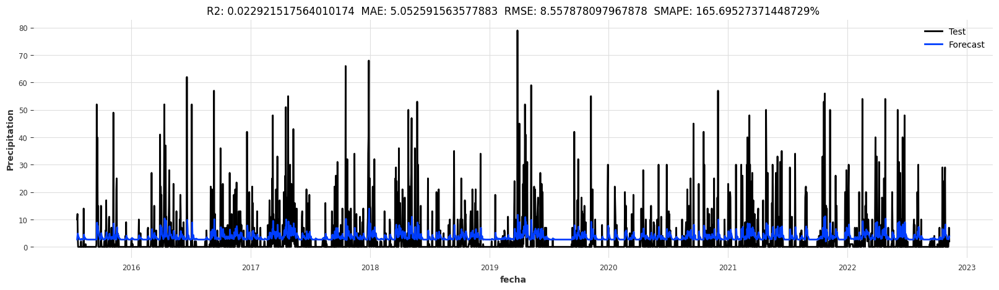

In [ ]:
plt.figure(figsize=(20, 5))
test_ts.plot(label="Test")
back_ts.plot(label="Forecast")
plt.title('R2: '+str(r2_score(test_ts,back_ts))+ '  MAE: '+str(mae(test_ts,back_ts))+ '  RMSE: '+str(rmse(test_ts,back_ts))+ '  SMAPE: '+str(smape(test_ts,back_ts))+"%")
plt.legend()
plt.grid('on')
plt.ylabel('Precipitation')
plt.xlabel("fecha");

# **3. Modelo de Redes Neuronales Basado en Redes Neuronales Recurrentes:**

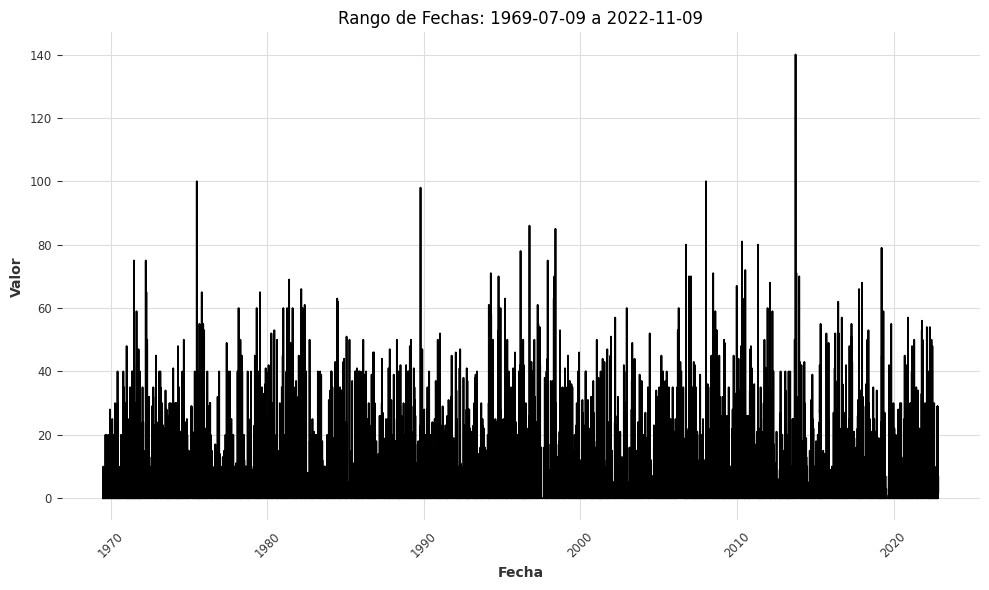

In [ ]:
# Example usage
plot_date_range(df_ff, '1969-07-09 00:00:00', '2022-11-09 00:00:00') # replace with your desired dates

In [ ]:
RNN_train, RNN_test=partir_dataframe(df_ff_keras, '2012-03-09 00:00:00', '2012-03-10 00:00:00')

Fechas train      : 1969-07-09 00:00:00 --- 2012-03-09 00:00:00
Fechas test       : 2012-03-10 00:00:00 --- 2022-11-09 00:00:00


In [ ]:
window = 6
horizon = 3

In [ ]:
X_trainRNN, X_testRNN, y_trainRNN, y_test=train_split(RNN_train, RNN_test, window, horizon)

(15568, 9) (3916, 9)
--------
Entrenamiento: (15568, 6) (15568, 3) 
Prueba: (3916, 6) (3916, 3)


##RNN Básica

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ simple_rnn_2 (SimpleRNN)             │ (None, None, 10)            │             120 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ simple_rnn_3 (SimpleRNN)             │ (None, 10)                  │             210 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_18 (Dense)                     │ (None, 3)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 363 (1.42 KB)

 Trainable params: 363 (1.42 KB)

 Non-trainable params: 0 (0.00 B)

CPU times: user 83.3 ms, sys: 2.87 ms, total: 86.2 ms
Wall time: 161 ms


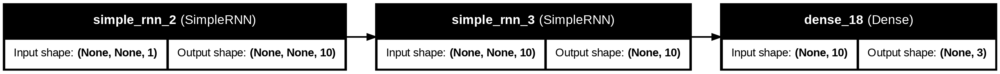

In [ ]:
%%time
keras.utils.set_random_seed(42)
modelo_RNN = keras.models.Sequential()
modelo_RNN.add(keras.layers.SimpleRNN(10, return_sequences=True, input_shape=[None, 1]))
modelo_RNN.add(keras.layers.SimpleRNN(10))
modelo_RNN.add(keras.layers.Dense(horizon, activation = 'linear'))
# Se muestra el resumen de la arquitectura del modelo
modelo_RNN.summary()
# Se muestra un esquema del modelo
keras.utils.plot_model(modelo_RNN, to_file='model_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='modelRNN.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=10, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 2, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_RNN.compile('adam','huber', metrics=['mse'])
historia = modelo_RNN.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=250,verbose=1,
                      callbacks=callbacks,shuffle=True)

Epoch 1/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0032 - mse: 0.0064
Epoch 1: val_loss improved from inf to 0.00194, saving model to modelRNN.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0032 - mse: 0.0064 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 2/250
381/390 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00194 to 0.00193, saving model to modelRNN.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 3/250
381/390 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss did not improve from 0.00193

Epoch 3: ReduceLROnPlateau reducing learning rate to 0.000800000037997961.
390/390 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 4/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - loss: 0.00

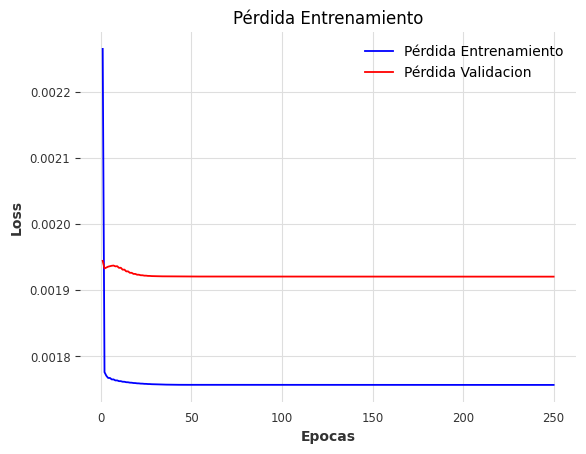

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
modelo_RNN = mod.load_model('modelRNN.best.keras')
predictions_RNN = modelo_RNN.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step


In [ ]:
predictions_RNN = predictions_RNN[:len(y_test)]

# Now calculate the metrics
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_RNN)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_RNN)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_RNN))*100)
#print("R2:", r2_score(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_RNN)))

RMSE: 8.50359440378529
MAE: 4.814243764600504
MAPE: 1.0112443574577696e+18


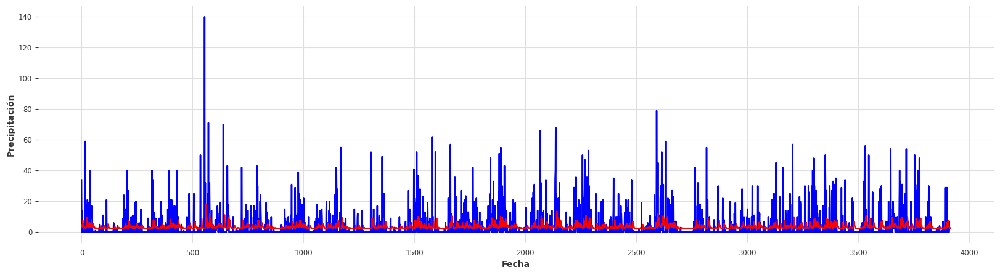

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_RNN),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##LSTM

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 6, 6)                │             192 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 6)                   │             312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_19 (Dense)                     │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525 (2.05 KB)

 Trainable params: 525 (2.05 KB)

 Non-trainable params: 0 (0.00 B)

CPU times: user 153 ms, sys: 3.97 ms, total: 157 ms
Wall time: 577 ms


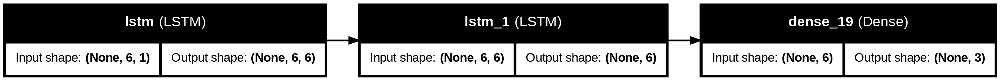

In [ ]:
%%time
keras.utils.set_random_seed(42)
modelo_LSTM = keras.models.Sequential()
modelo_LSTM.add(keras.layers.LSTM(6, return_sequences=True, activation='relu', input_shape=[window, 1]))
modelo_LSTM.add(keras.layers.LSTM(6, activation='relu'))
modelo_LSTM.add(keras.layers.Dense(horizon, activation = 'linear'))
modelo_LSTM.summary()
keras.utils.plot_model(modelo_LSTM, to_file='model_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='modelLSTM.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=10, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_LSTM.compile('adam','huber', metrics=['mse'])
historia = modelo_LSTM.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=250,verbose=1,
                      callbacks=callbacks,shuffle=True)

Epoch 1/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0019 - mse: 0.0039
Epoch 1: val_loss improved from inf to 0.00194, saving model to modelLSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - loss: 0.0019 - mse: 0.0039 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 2/250
387/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00194 to 0.00193, saving model to modelLSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 3/250
385/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss improved from 0.00193 to 0.00192, saving model to modelLSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 4/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - loss: 0.0019 - mse: 0.0038
Epoch 4: val_l

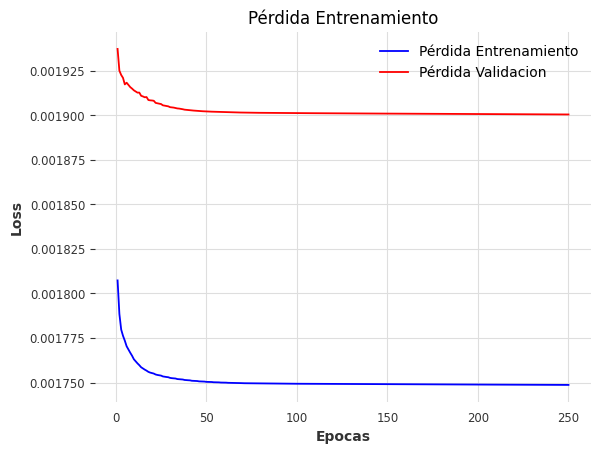

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_LSTM = mod.load_model('modelLSTM.best.keras')
predictions_LSTM = model_LSTM.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step


In [ ]:
# Since y_test has more samples, we need to consider where the mismatch occurs.
# Assuming the extra samples are at the beginning of y_test, you can slice y_test:
y_test = y_test[len(y_test) - len(predictions_LSTM):]

# If extra samples are at the end of y_test:
# y_test = y_test[:len(predictions_LSTM)]

# Now, re-run the evaluation metrics:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM))*100)
#print("R2:", r2_score(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM)))

RMSE: 7.998850343047647
MAE: 4.423865636262914
MAPE: 9.217610174941582e+17


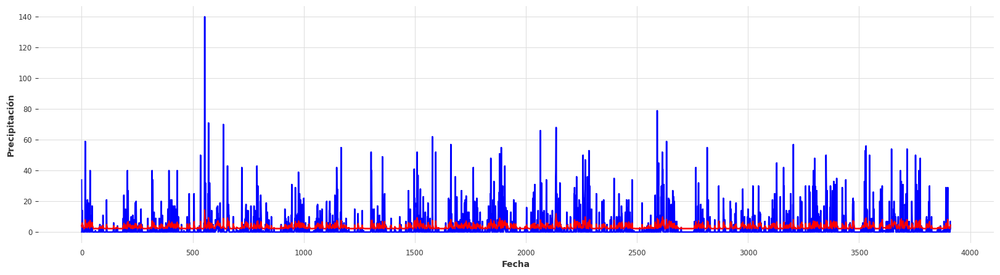

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_LSTM),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##LSTM - POTENCIADA

In [ ]:
def set_seed(seed):
  tf.random.set_seed(seed)
  os.environ['PYTHONHASHSEED'] = str(seed)
  np.random.seed(seed)
  random.seed(seed)

##ARQUITECTURA: LSTM - POTENCIADA

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 6, 6)                │             192 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 6)                   │             312 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_21 (Dense)                     │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525 (2.05 KB)

 Trainable params: 525 (2.05 KB)

 Non-trainable params: 0 (0.00 B)

CPU times: user 119 ms, sys: 5.16 ms, total: 124 ms
Wall time: 245 ms


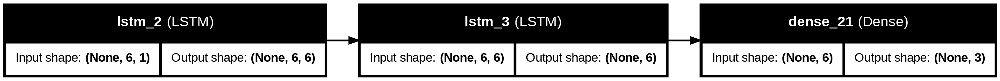

In [ ]:
%%time
set_seed(42)
modelo_LSTM = keras.models.Sequential()
modelo_LSTM.add(keras.layers.LSTM(6, return_sequences=True, activation='tanh', input_shape=[window, 1]))
modelo_LSTM.add(keras.layers.LSTM(6, activation='tanh'))
modelo_LSTM.add(keras.layers.Dense(horizon, activation = 'linear'))
modelo_LSTM.summary()
keras.utils.plot_model(modelo_LSTM, to_file='modelLSTM_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='modelLSTMPotenciado.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=10, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_LSTM.compile('adam','huber', metrics=['mse'])
historia = modelo_LSTM.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=250,verbose=1,
                      callbacks=callbacks,shuffle=True)

Epoch 1/250
388/390 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0019 - mse: 0.0038
Epoch 1: val_loss improved from inf to 0.00192, saving model to modelLSTMPotenciado.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 2/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss did not improve from 0.00192
390/390 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 3/250
381/390 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss did not improve from 0.00192
390/390 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 4/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 4: val_loss did not improve from 0.00192
390/390 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step -

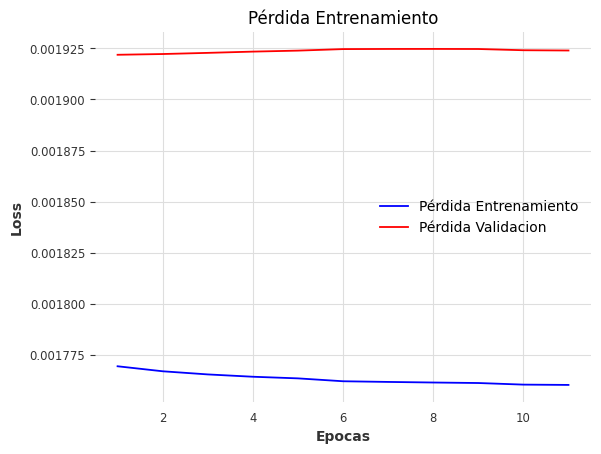

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_LSTM_potenciado = mod.load_model('modelLSTMPotenciado.best.keras')
predictions_LSTM_potenciado = model_LSTM.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_LSTM))*100)

RMSE: 7.998850343047647
MAE: 4.423865636262914
MAPE: 9.217610174941582e+17


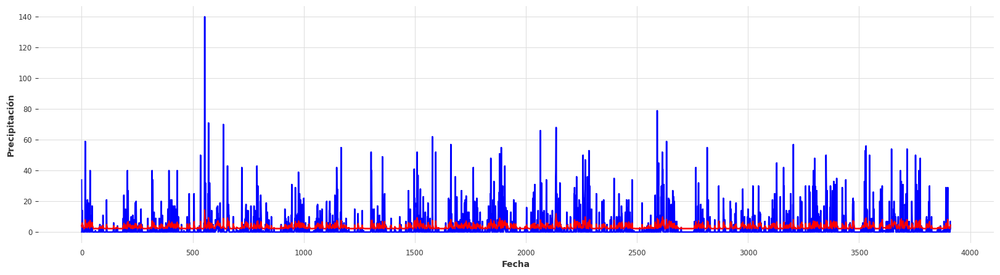

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_LSTM),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##ConvLSTM1D

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow import keras
from random import seed
from tensorflow.keras import callbacks as call
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error
import math
import matplotlib.pyplot as plt


def Conv_LSTM(param, window, horizon):
    set_seed(42)
    # Import Input from tensorflow.keras.layers
    inp = Input(shape=(window, 1))
    res = Reshape(target_shape=(1, window, 1))(inp)
    x = ConvLSTM1D(filters=param['unit_1'], kernel_size=param['k_unit_1'], padding='same', activation=param['act'], return_sequences=True)(res)
    x = ConvLSTM1D(filters=param['unit_2'], kernel_size=param['k_unit_2'], padding='same', activation=param['act'], return_sequences=True)(x)
    x = Flatten()(x)
    out = Dense(horizon, name='output', activation='linear')(x)
    m = Model(inp, out)
    m.compile(loss={'output': 'huber'},
              metrics=['mse'], optimizer=Adam(learning_rate=param['lr']))
    return m

In [ ]:
param_grid = {
    'unit_1': 6,
    'unit_2': 6,
    'k_unit_1': 5,
    'k_unit_2': 5,
    'lr': 1e-3,
    'act': 'tanh',
}

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='model_Conv_LSTM1D.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=15, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_Conv_LSTM = Conv_LSTM(param_grid, window, horizon)

historia = modelo_Conv_LSTM.fit(X_train,y_train,
                               validation_split=0.2,
                               epochs=250,verbose=1,
                               callbacks=callbacks,shuffle=True)

Epoch 1/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0019 - mse: 0.0039
Epoch 1: val_loss improved from inf to 0.00192, saving model to model_Conv_LSTM1D.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 11s 15ms/step - loss: 0.0019 - mse: 0.0039 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 2/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00192 to 0.00192, saving model to model_Conv_LSTM1D.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 3/250
378/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss did not improve from 0.00192
390/390 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 4/250
370/390 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 0.0019 - mse: 0.0038
Epoch 4: val_loss did not improve from 0

In [ ]:
modelo_Conv_LSTM.summary()

Model: "functional_101"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_25 (InputLayer)          │ (None, 6, 1)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_13 (Reshape)                 │ (None, 1, 6, 1)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv_lstm1d_26 (ConvLSTM1D)          │ (None, 1, 6, 6)             │             864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv_lstm1d_27 (ConvLSTM1D)          │ (None, 1, 6, 6)             │           1,464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_17 (Flatten)                 │ (None, 36)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ output (Dense)                       │ (None, 3)                   │             111 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,319 (28.59 KB)

 Trainable params: 2,439 (9.53 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,880 (19.07 KB)

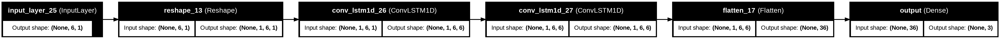

In [ ]:
keras.utils.plot_model(modelo_Conv_LSTM, to_file='modelCLSTM_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

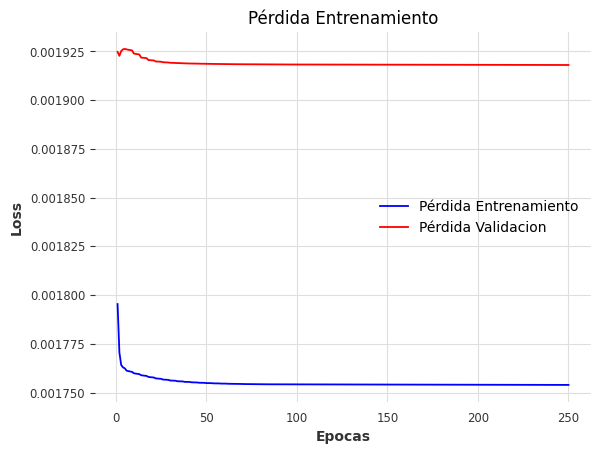

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_Conv_LSTM1D = mod.load_model('model_Conv_LSTM1D.best.keras')
predictions_Conv_LSTM1D = model_Conv_LSTM1D.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Conv_LSTM1D)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Conv_LSTM1D)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Conv_LSTM1D))*100)

RMSE: 8.572599115042133
MAE: 4.872241715017272
MAPE: 1.0355438875955784e+18


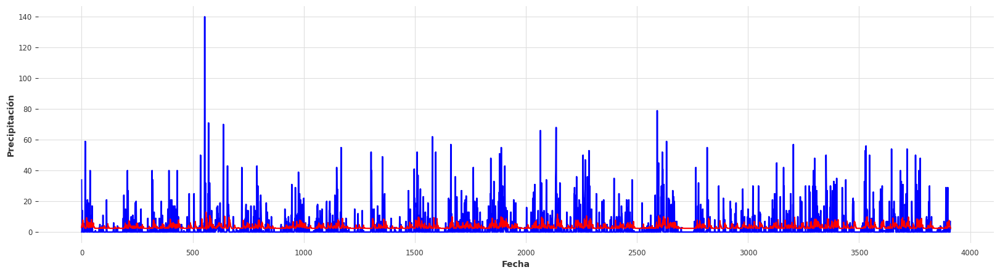

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_Conv_LSTM1D),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##LSTM + Time2Vec

In [ ]:
from tensorflow import keras
from tensorflow.keras.layers import Layer, Concatenate # Import Concatenate from keras.layers
from tensorflow.keras import backend as K

@tf.keras.utils.register_keras_serializable() # Use tf.keras.utils.register_keras_serializable instead of keras.saving.register_keras_serializable
class T2V(Layer):

  def __init__(self, output_dim=None, **kwargs):
    self.output_dim = output_dim
    super(T2V, self).__init__(**kwargs)

  def build(self, input_shape):
    self.W = self.add_weight(name='W',
                             shape=(input_shape[-1], self.output_dim),
                             initializer='uniform',
                             trainable=True)

    self.P = self.add_weight(name='P',
                             shape=(input_shape[1], self.output_dim),
                             initializer='uniform',
                             trainable=True)

    self.w = self.add_weight(name='w',
                             shape=(input_shape[1], 1),
                             initializer='uniform',
                             trainable=True)

    self.p = self.add_weight(name='p',
                             shape=(input_shape[1], 1),
                             initializer='uniform',
                             trainable=True)

    super(T2V, self).build(input_shape)

  def call(self, x):
    original = self.w * x + self.p
    sin_trans = K.sin(K.dot(x, self.W) + self.P)
    return backend.concatenate([sin_trans, original], -1)

In [ ]:
def T2V_LSTM(param, window, horizon):
  set_seed(42)
  inp = Input(shape=(window,1))
  x = T2V(param['T2V_dim'])(inp)
  x = Concatenate(axis=-1)([inp, x])
  x = keras.layers.LSTM(param['unit_1'], activation=param['act'], return_sequences=True)(x)
  x = keras.layers.LSTM(param['unit_2'], activation=param['act'])(x)
  output = Dense(horizon, name='output', activation='linear')(x)
  m = Model(inp, outputs=[output])
  m.compile(loss={'output':'huber'},
            metrics=['mse'], optimizer=Adam(learning_rate=param['lr']))
  return m

In [ ]:
param_grid = {
    'unit_1': 6,
    'unit_2': 6,
    'T2V_dim':24,
    'lr': 1e-3,
    'act': 'tanh',
}

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='model_T2V_LSTM.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=15, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_T2V_LSTM = T2V_LSTM(param_grid, window, horizon)

historia = modelo_T2V_LSTM.fit(X_train,y_train,
                               validation_split=0.2,
                               epochs=250,verbose=1,
                               callbacks=callbacks,shuffle=True)

Epoch 1/250
387/390 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0019 - mse: 0.0038
Epoch 1: val_loss improved from inf to 0.00193, saving model to model_T2V_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 2/250
383/390 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00193 to 0.00193, saving model to model_T2V_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 3/250
389/390 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss improved from 0.00193 to 0.00192, saving model to model_T2V_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 4/250
388/390 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0019 - mse: 0.0038


In [ ]:
modelo_T2V_LSTM.summary()

Model: "functional_102"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_31            │ (None, 6, 1)           │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ t2v_5 (T2V)               │ (None, 6, 25)          │            180 │ input_layer_31[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_1             │ (None, 6, 26)          │              0 │ input_layer_31[0][0],  │
│ (Concatenate)             │                        │                │ t2v_5[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_4 (LSTM)             │ (None, 6, 6)           │            792 │ concatenate_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_5 (LSTM)             │ (None, 6)              │            312 │ lstm_4[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ output (Dense)            │ (None, 3)              │             21 │ lstm_5[0][0]           │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 3,917 (15.30 KB)

 Trainable params: 1,305 (5.10 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 2,612 (10.21 KB)

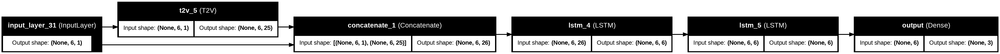

In [ ]:
keras.utils.plot_model(modelo_T2V_LSTM, to_file='modelT2VLSTM_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

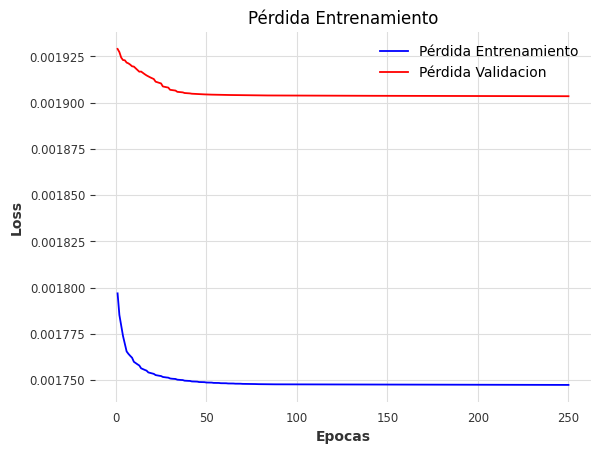

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_T2V_LSTM = mod.load_model('model_T2V_LSTM.best.keras')
predictions_T2V_LSTM = model_T2V_LSTM.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_T2V_LSTM)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_T2V_LSTM)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_T2V_LSTM))*100)

RMSE: 8.582052548112918
MAE: 4.84785808377227
MAPE: 1.024313674657988e+18


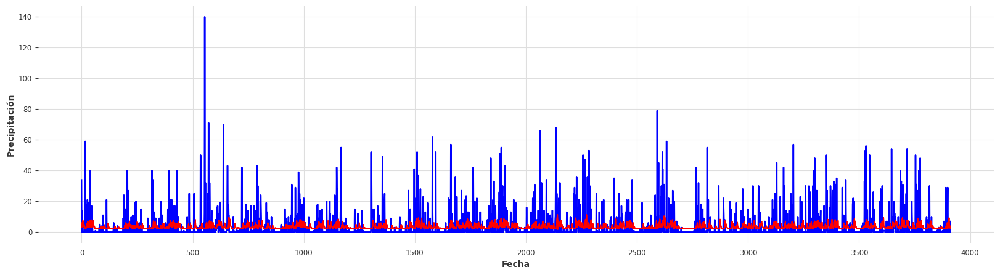

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_T2V_LSTM),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##LSTM + Attention

In [ ]:
def Att_LSTM(param, window, horizon):
  set_seed(42)
  inp = Input(shape=(window,1))
  x = keras.layers.LSTM(param['unit_1'], activation=param['act'], return_sequences=True)(inp)
  x = keras.layers.MultiHeadAttention(key_dim=param['head_size'], num_heads=param['n_heads'], dropout=param['dropout'])(x, x)
  x = keras.layers.LSTM(param['unit_2'], activation=param['act'])(x)
  output = Dense(horizon, name='output', activation='linear')(x)
  m = Model(inp, outputs=[output])
  m.compile(loss={'output':'huber'},
            metrics=['mse'], optimizer=Adam(learning_rate=param['lr']))
  return m

In [ ]:
param_grid = {
    'unit_1': 6,
    'unit_2': 6,
    'head_size': 128,
    'n_heads': 6,
    'dropout': 0.2,
    'lr': 1e-3,
    'act': 'tanh',
}

In [ ]:
callbacks = [call.ModelCheckpoint(filepath='model_Att_LSTM.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=15, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_Att_LSTM = Att_LSTM(param_grid, window, horizon)

historia = modelo_Att_LSTM.fit(X_train,y_train,
                               validation_split=0.2,
                               epochs=250,verbose=1,
                               callbacks=callbacks,shuffle=True)

Epoch 1/250
388/390 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0019 - mse: 0.0039
Epoch 1: val_loss improved from inf to 0.00193, saving model to model_Att_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - loss: 0.0019 - mse: 0.0039 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 2/250
386/390 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00193 to 0.00193, saving model to model_Att_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 3/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss improved from 0.00193 to 0.00193, saving model to model_Att_LSTM.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 6s 10ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0039 - learning_rate: 0.0010
Epoch 4/250
390/390 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0019 - mse: 0.003

In [ ]:
modelo_Att_LSTM.summary()

Model: "functional_103"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_34            │ (None, 6, 1)           │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_7 (LSTM)             │ (None, 6, 6)           │            192 │ input_layer_34[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention      │ (None, 6, 6)           │         20,742 │ lstm_7[0][0],          │
│ (MultiHeadAttention)      │                        │                │ lstm_7[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_8 (LSTM)             │ (None, 6)              │            312 │ multi_head_attention[… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ output (Dense)            │ (None, 3)              │             21 │ lstm_8[0][0]           │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 63,803 (249.23 KB)

 Trainable params: 21,267 (83.07 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 42,536 (166.16 KB)

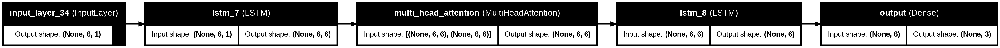

In [ ]:
keras.utils.plot_model(modelo_Att_LSTM, to_file='modelAttLSTM_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

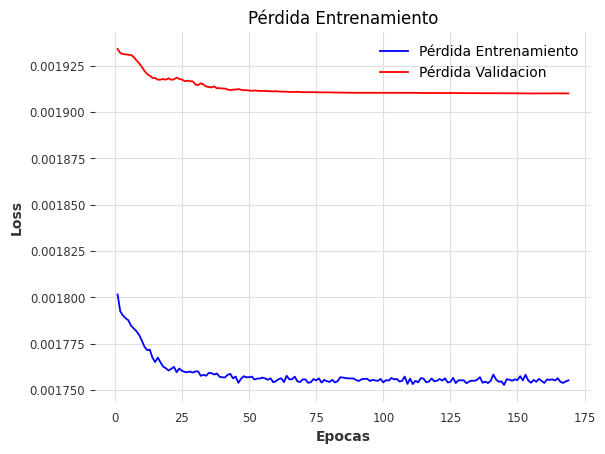

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_Att_LSTM = mod.load_model('model_Att_LSTM.best.keras')
predictions_Att_LSTM = model_Att_LSTM.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Att_LSTM)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Att_LSTM)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_Att_LSTM))*100)

RMSE: 8.566960055218496
MAE: 4.861459407029545
MAPE: 1.031183102396032e+18


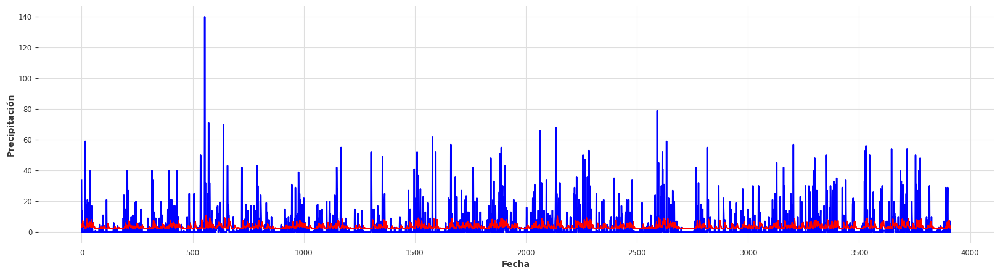

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_Att_LSTM),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");

##GRU

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ gru (GRU)                            │ (None, 6, 6)                │             162 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ gru_1 (GRU)                          │ (None, 6)                   │             252 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_20 (Dense)                     │ (None, 3)                   │              21 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 435 (1.70 KB)

 Trainable params: 435 (1.70 KB)

 Non-trainable params: 0 (0.00 B)

CPU times: user 102 ms, sys: 5.9 ms, total: 108 ms
Wall time: 192 ms


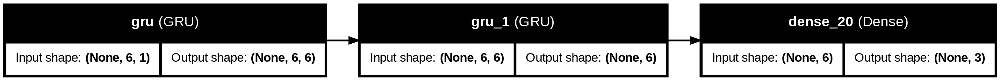

In [ ]:
%%time
keras.utils.set_random_seed(42)
modelo_GRU = keras.models.Sequential()
modelo_GRU.add(keras.layers.GRU(6, return_sequences=True, input_shape=[window, 1]))
modelo_GRU.add(keras.layers.GRU(6))
modelo_GRU.add(keras.layers.Dense(horizon, activation = 'linear'))
modelo_GRU.summary()
keras.utils.plot_model(modelo_GRU, to_file='model_plot.png', show_shapes=True, show_layer_names=True,rankdir='LR')

In [ ]:
%%time
callbacks = [call.ModelCheckpoint(filepath='modelGRU.best.keras', verbose = 1, save_best_only=True),\
             call.EarlyStopping(patience=10, restore_best_weights=True),\
             call.ReduceLROnPlateau(monitor='val_loss', patience = 4, verbose = 1, factor = 0.8, min_lr = 1e-5)]

modelo_GRU.compile('adam','huber', metrics=['mse'])
historia = modelo_GRU.fit(X_train,y_train,
                      validation_split=0.2,
                      epochs=250,verbose=1,
                      callbacks=callbacks,shuffle=True)

Epoch 1/250
385/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 1: val_loss improved from inf to 0.00192, saving model to modelGRU.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 2/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 2: val_loss improved from 0.00192 to 0.00192, saving model to modelGRU.best.keras
390/390 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 3/250
387/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 3: val_loss did not improve from 0.00192
390/390 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.0019 - mse: 0.0038 - val_loss: 0.0019 - val_mse: 0.0038 - learning_rate: 0.0010
Epoch 4/250
384/390 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0019 - mse: 0.0038
Epoch 4: val_loss did not improve from 0.00192
390/390 ━━━━━

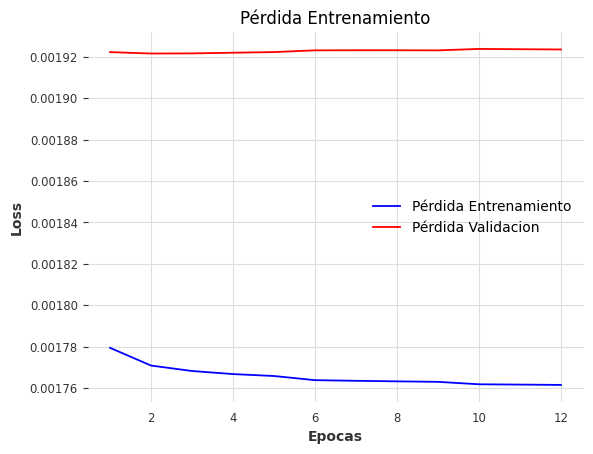

In [ ]:
perdida_train = historia.history['loss']
perdida_test = historia.history['val_loss']
epocas = range(1, len(perdida_train) + 1)

plt.plot(epocas, perdida_train, 'b', label='Pérdida Entrenamiento')
plt.plot(epocas, perdida_test, 'r', label='Pérdida Validacion')
plt.title('Pérdida Entrenamiento')
plt.xlabel('Epocas')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
model_GRU = mod.load_model('modelGRU.best.keras')
predictions_GRU = model_GRU.predict(X_test)

123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [ ]:
print("RMSE:", root_mean_squared_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_GRU)))
print("MAE:",mean_absolute_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_GRU)))
print("MAPE:",mean_absolute_percentage_error(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_GRU))*100)
#print("R2:", r2_score(scaler_keras.inverse_transform(y_test), scaler_keras.inverse_transform(predictions_GRU)))

RMSE: 8.574721424861721
MAE: 4.75590268014724
MAPE: 9.71028430557944e+17


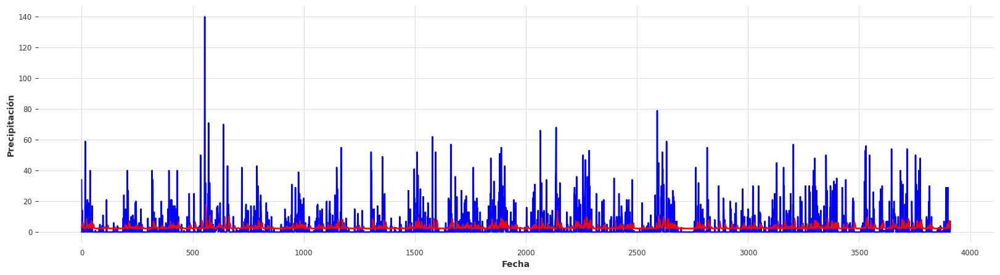

In [ ]:
plt.figure(figsize=(20, 5))
plt.plot(scaler_keras.inverse_transform(y_test),'b',scaler_keras.inverse_transform(predictions_GRU),'r')
plt.grid('on')
plt.ylabel('Precipitación')
plt.xlabel("Fecha");